# 2. Let's Help Santa!

In [ ]:
from google.colab import drive
drive.mount("/content/drive/")

# add system path to current directory
import sys
sys.path.insert(1, '/content/drive/MyDrive/Colab Notebooks/ECE_232E/Project4')
%cd "/content/drive/MyDrive/Colab Notebooks/ECE_232E/Project4"

Mounted at /content/drive/
/content/drive/MyDrive/Colab Notebooks/ECE_232E/Project4


In [ ]:
!pip install igraph

In [ ]:
!sudo apt install libcairo2-dev pkg-config python3-dev

In [ ]:
!pip install pycairo

In [ ]:
!pip install cairocffi

In [ ]:
import igraph
from igraph import *
import networkx as nx
import json
import random
import numpy as np
from numpy import linalg 
import itertools
import matplotlib.pyplot as plt
from scipy.spatial import Delaunay  # needed for triangulation
import os
import pandas as pd
from copy import deepcopy

random.seed(2022)
np.random.seed(2022)

%matplotlib inline

### 2. Build Your Graph

<div class="alert alert-block alert-success">
<b>Question 9:</b> Report the number of nodes and edges in G.
</div>

In [ ]:
df = pd.read_csv('los_angeles-censustracts-2019-4-All-MonthlyAggregate.csv', 
                 usecols=['sourceid', 'dstid', 'month', 'mean_travel_time'])

# get December data
df_12 = df[df['month']==12]

# sort the data
graph_dict = {}
for s_id, d_id, month, mtt in df_12.values:
    key = tuple(np.sort([int(s_id), int(d_id)]))
    if key in graph_dict: 
        graph_dict[key].append(mtt)
    else: 
        graph_dict[key] = [mtt]

# save the data with the average time 
with open('graph_data_12.txt','w') as f:
    for loc in graph_dict:
        f.write('{} {} {}\n'.format(loc[0], loc[1], np.mean(graph_dict[loc])))

# create the graph
g = Graph.Read(f='graph_data_12.txt', format='ncol', directed = False)
gcc = g.components().giant()
print("Number of nodes: {}".format(len(gcc.vs)))
print("Number of edges: {}".format(len(gcc.es)))

Number of nodes: 2649
Number of edges: 1004955


<div class="alert alert-block alert-success">
<b>Answer 9:</b> The number of nodes is 2649 and edges is 1004955
</div>

### 3. Traveling Salesman Problem

<div class="alert alert-block alert-success">
<b>Question 10:</b> Build a minimum spanning tree (MST) of graph G. Report the street addresses near the two endpoints (the centroid locations) of a few edges. Are the results intuitive?
</div>

In [ ]:
# build minimum spanning tree
mst = gcc.spanning_tree(weights = gcc.es["weight"])

# get location data with mean centroid coordinates
display_names = dict()
coordinates = dict()
with open('los_angeles_censustracts.json', 'r') as f:
    census_tracts = json.loads(f.readline())
    for area in census_tracts['features']:
        id = int(area['properties']['MOVEMENT_ID'])
        display_name = area['properties']['DISPLAY_NAME']
        display_names[id] = display_name
        a = area['geometry']['coordinates'][0]
        coordinates[id] = np.array(a if type(a[0][0]) == float else a[0]).mean(axis=0)

# display some edges
mst_edges = mst.es()
print("The street addresses near the two endpoints (the centroid locations) of a few edges:\n")
for e in mst_edges[:5]:
    s_id = int(mst.vs(e.tuple[0])[0]['name'])
    d_id = int(mst.vs(e.tuple[1])[0]['name'])
    print("     Source Name: {} and Coordinates: {}".format(display_names[s_id], coordinates[s_id]))
    print("Destimation Name: {} and Coordinates: {}\n".format(display_names[d_id], coordinates[d_id]))

The street addresses near the two endpoints (the centroid locations) of a few edges:

     Source Name: Census Tract 554001 and Coordinates: [-118.13267851   33.89999556]
Destimation Name: Census Tract 554002 and Coordinates: [-118.13507006   33.89227386]

     Source Name: Census Tract 461700 and Coordinates: [-118.16330189   34.15868384]
Destimation Name: Census Tract 460800 and Coordinates: [-118.17726051   34.16517255]

     Source Name: Census Tract 302201 and Coordinates: [-118.24905075   34.1446301 ]
Destimation Name: Census Tract 302202 and Coordinates: [-118.24895015   34.14108379]

     Source Name: Census Tract 407101 and Coordinates: [-117.9725598    34.04877965]
Destimation Name: Census Tract 407002 and Coordinates: [-117.98015808   34.05248923]

     Source Name: Census Tract 433401 and Coordinates: [-118.04268341   34.05802424]
Destimation Name: Census Tract 433402 and Coordinates: [-118.03738973   34.05662518]



<div class="alert alert-block alert-success">
<b>Answer 10:</b> The correspondings address names are:

<ul>
  <li>Source Address: 9452 Heiner Street, Bellflower, CA 90706, United States of America</li>
  <li>Destination Address: Seventh Day Adventist School, Woodington Avenue, Bellflower, CA 90706, United States of America</li>
  <li>Source Address: 729 Seco Street, Pasadena, CA 91103, United States of America</li>
  <li>Destination Address: 1283 El Mirador Drive, Linda Vista, Pasadena, CA 91103, United States of America</li>
  <li>Source Address: The Otto Gruber House, East Harvard Street, Glendale, CA 91210, United States of America</li>
  <li>Destination Address: 565 East Lomita Avenue, Glendale, CA 91205, United States of America</li>
  <li>Source Address: 14175 Homeward Street, La Puente, CA 91746, United States of America</li>
  <li>Destination Address: Puente Avenue, El Monte, CA 91746, United States of America</li>
  <li>Source Address: Foothill Transit 269, Santa Anita Avenue, South El Monte, CA 91733, United States of America</li>
  <li>Destination Address: 10921 Klingerman Street, South El Monte, CA 91733, United States of America</li>
</ul>

Yes, the results are intuitive. According to the map distance, one can see that each pair of street addresses of the endpoints are very close to each other, resulting in the lowest cumulative mean travel time, which is what MST wants to achieve.
</div>

<div class="alert alert-block alert-success">
<b>Question 11:</b> Determine what percentage of triangles in the graph (sets of 3 points on the map) satisfy the triangle inequality. You do not need to inspect all triangles, you can just estimate by random sampling of 1000 triangles.
</div>

In [ ]:
def is_triangle(sides):
    # write code here
    ew1, ew2, ew3 = sides[0], sides[1], sides[2]
    if ew1+ew2>ew3 and ew2+ew3>ew1 and ew3+ew1>ew2:
        return True 
    else: 
        return False

# print('Test:', is_triangle([1,4,2]), is_triangle([3,5,3]))


def sample_triangles(g, n_samples):
    result = list()
    while len(result) < n_samples:
        vertices = tuple(np.random.randint(1, high=len(g.vs), size=3))
        try:
            e1 = g.get_eid(vertices[0], vertices[1])
            e2 = g.get_eid(vertices[1], vertices[2])
            e3 = g.get_eid(vertices[2], vertices[0])
            result.append(vertices)
        except: 
            continue

    # result will have tuple of the the vertices of a triangle 
    return result

In [ ]:
n_samples = 1000  # WARNING: this might take a minute for larger sample sizes
triangles = 0
sampled = sample_triangles(gcc, n_samples)

for triangle_vs in sampled:
    
    edge_lengths = []
    
    for i in range(3):
        for j in range(i):
            edge_lengths.append(min(gcc.es.select(_between=([triangle_vs[i]], [triangle_vs[j]]))['weight']))   
            
    triangles += is_triangle(edge_lengths)
    
print('Triangle inequality holds by {}%'.format(round(100.0 * triangles / n_samples, 1)))

Triangle inequality holds by 92.2%


<div class="alert alert-block alert-success">
<b>Answer 11:</b> The estimated percentage of triangles in the graph satisfy the triangle inequality is around 92.2%
</div>

<div class="alert alert-block alert-success">
<b>Question 12:</b> Find an upper bound on the empirical performance of the approximate algorithm:

$$
\rho = \frac{\text{Approximate TSP Cost}}{\text{Optimal TSP Cost}}
$$
</div>

In [ ]:
df_values = df_12[['sourceid', 'dstid', 'mean_travel_time']].values
for i in range(0, len(df_values)):
    if(df_values[i][0] > df_values[i][1]):
        t = df_values[i][0]
        df_values[i][0] = df_values[i][1]
        df_values[i][1] = t

reorder_df = pd.DataFrame(df_values).groupby([0,1]).mean().reset_index()
reorder_df = reorder_df.rename(columns={0: "sourceid", 1: "dstid", 2: "weight"})

g = nx.from_pandas_edgelist(reorder_df, "sourceid", "dstid", ["weight"])
gcc = g.subgraph(max(nx.connected_components(g), key=len))
mst = nx.minimum_spanning_tree(gcc)
mg = nx.MultiGraph()
# mst_cost = 0
for i, j in mst.edges:
    w = mst.edges[i, j]['weight']
    # mst_cost += w
    mg.add_edge(i, j, weight=w)
    mg.add_edge(i, j, weight=w)

vertices, count = [], 0
for i in mg.nodes:
    vertices.append(i)
    count += 1
    if count > 60: 
        break

costs, cur_paths = [], []
for vertex in vertices:
    tour = [u for u,v in nx.eulerian_circuit(mg, source=vertex)]
    cur_path, visited_nodes = [], set()
    for i in tour:
        if i not in visited_nodes: 
            cur_path.append(i) 
            visited_nodes.add(i) 
    cur_path.append(cur_path[0])
    cur_paths.append(cur_path)

    approx_cost = 0
    for i in range(len(cur_path)-1):
        s,t = cur_path[i], cur_path[i+1]
        w = 0
        if mst.has_edge(s,t): 
            w = mst.edges[s,t]['weight']
        else: 
            w = nx.dijkstra_path_length(gcc, s, t)
        approx_cost += w
    costs.append(approx_cost)

tsp_cost = min(costs)
tsp_trajectory = cur_paths[np.argmin(costs)]
mst_cost = sum([mst.edges[i, j]['weight'] for i, j in mst.edges])

In [ ]:
print('MST Cost:', round(mst_cost))
print('TSP Cost:', round(tsp_cost))
print('Ratio:', round(tsp_cost/mst_cost, 2))

MST Cost: 269085
TSP Cost: 421489
Ratio: 1.57


<div class="alert alert-block alert-success">
<b>Answer 12:</b> The upper bound on the empirical performance of the approximate algorithm is around 1.57
</div>

<div class="alert alert-block alert-success">
<b>Question 13:</b> Plot the trajectory that Santa has to travel!
</div>

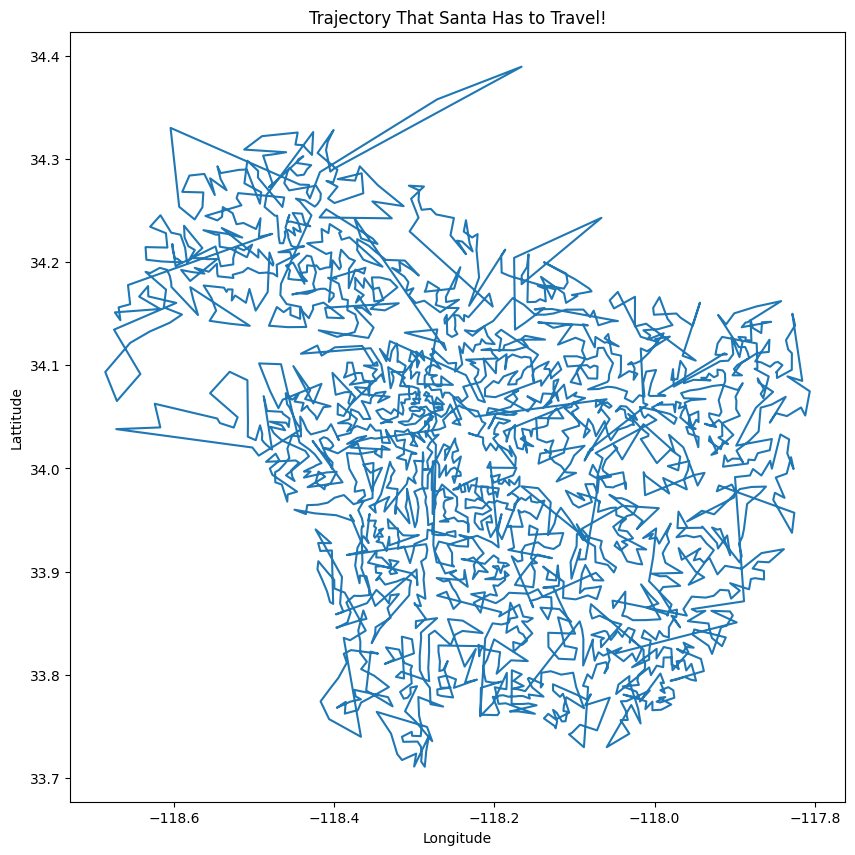

In [ ]:
data = json.load(open('los_angeles_censustracts.json'))
tsp_coordinates = []
for i in tsp_trajectory:
    for j in range(len(data['features'])):
        if data['features'][j]['properties']['MOVEMENT_ID']==str(int(i)):
            cur_loc = data['features'][j]['geometry']['coordinates'][0]
            if len(cur_loc)==1:
                t = np.asarray(cur_loc[0]).mean(axis=0)
                tsp_coordinates.append(t)
            elif len(cur_loc)==2:
                t = np.asarray(cur_loc[0]+cur_loc[1]).mean(axis=0)
                tsp_coordinates.append(t)
            elif i==1932.0:
                t = np.asarray(cur_loc[0]+cur_loc[1]+cur_loc[2]+cur_loc[3]+cur_loc[4]+cur_loc[5]).mean(axis=0)
                tsp_coordinates.append(t)
            else: 
                t = np.asarray(cur_loc).mean(axis=0)
                tsp_coordinates.append(t)

tsp_coordinates = np.array(tsp_coordinates)
plt.figure(figsize=(10,10))
plt.plot(tsp_coordinates[:, 0], tsp_coordinates[:, 1],'-')
plt.title('Trajectory That Santa Has to Travel!')
plt.xlabel('Longitude')
plt.ylabel('Lattitude')
plt.show()

<div class="alert alert-block alert-success">
<b>Answer 13:</b> The result of the trajectory that Santa has to travel is shown above.
</div>

### 5. Estimate the Roads

<div class="alert alert-block alert-success">
<b>Question 14:</b> Plot the road mesh that you obtain and explain the result. Create a graph $G_{\Delta}$ whose nodes are different locations and its edges are produced by triangulation.
</div>

In [ ]:
# get location data with mean centroid coordinates
display_names = dict()
coordinates = dict()
with open('los_angeles_censustracts.json', 'r') as f:
    census_tracts = json.loads(f.readline())
    for area in census_tracts['features']:
        id = int(area['properties']['MOVEMENT_ID'])
        display_name = area['properties']['DISPLAY_NAME']
        display_names[id] = display_name
        a = area['geometry']['coordinates'][0]
        coordinates[id] = np.array(a if type(a[0][0]) == float else a[0]).mean(axis=0)

g = Graph(directed=False)
g.add_vertices(len(display_names))
g.vs['display_name'] = list(display_names.values())  # index = id - 1
g.vs['coordinates'] = list(coordinates.values())

month_filter = {12}  # for monthly aggregate data of 4th quarter, we can filter data based off of only December

edges = []
weights = []
with open('los_angeles-censustracts-2019-4-All-MonthlyAggregate.csv') as f:
    f.readline()  # skip the first line
    
    while True:
        line = f.readline()
        if line == '':
            break  # end of file
        
        vals = line.strip().split(',')
        
        # read edge info
        src, dest, month, dist = int(vals[0]), int(vals[1]), int(vals[2]), float(vals[3])

        # if data is not relevant, skip it
        if month not in month_filter:
            continue
            
        edges.append((src - 1, dest - 1))
        weights.append(dist)  

g.add_edges(edges)
g.es['weight'] = weights
del edges, weights

# keep only the giant connected component
components = g.components()
gcc = max(components, key=len)  # idx of vertex, not ids
vs_to_delete = [i for i in range(len(g.vs)) if i not in gcc]
g.delete_vertices(vs_to_delete)

# remove duplicate edges
g = g.simplify(combine_edges=dict(weight='mean'))  # combine duplicate edges

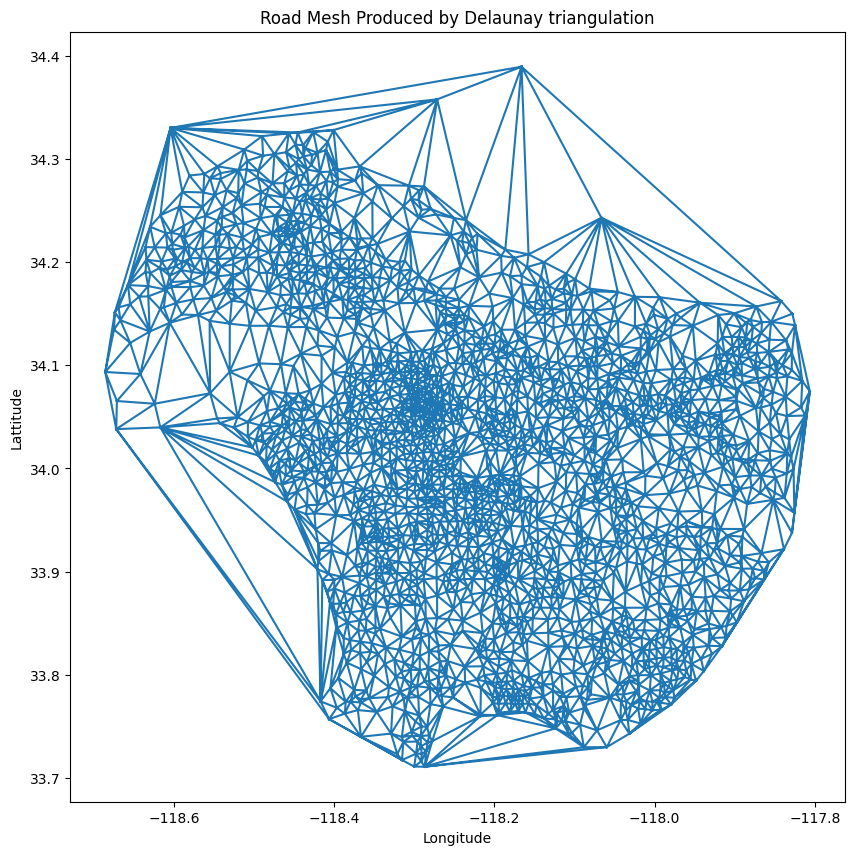

In [ ]:
tri = Delaunay(np.array([i["coordinates"] for i in g.vs]))

plt.figure(figsize=(10,10))
plt.triplot(np.array([i["coordinates"] for i in g.vs])[:, 0], 
            np.array([i["coordinates"] for i in g.vs])[:, 1], 
            tri.simplices.copy())
plt.title('Road Mesh Produced by Delaunay triangulation')
plt.xlabel('Longitude')
plt.ylabel('Lattitude')
plt.show()

Create a graph $G_{\Delta}$

In [ ]:
edges_to_induce = []

for i in range(tri.simplices.shape[0]):
    for col1, col2 in ((0, 1), (1, 2), (0, 2)):
        # add the edges to edges_to_induce
        try:
            edge = tuple(sorted((tri.simplices[i][col1], tri.simplices[i][col2])))
            e_id = g.get_eid(edge[0], edge[1])
            if edge not in edges_to_induce:
                edges_to_induce.append(edge)
        except:
            continue

In [ ]:
tri_g = g.subgraph_edges(edges_to_induce)
plot(tri_g, **dict(vertex_size=3))

<div class="alert alert-block alert-success">
<b>Answer 14:</b> The result of the road mesh is illustrated above. It is evident that the Delaunay triangulation algorithm has successfully captured the road structures in Los Angeles, particularly in the downtown area. However, there are instances where roads appear to traverse oceans and mountains, even though they do not exist. This phenomenon arises because the Delaunay triangulation algorithm strives to enclose each triangle within a circumcircle. This behavior becomes apparent in the second plot, which represents a subgraph encompassing all edges derived from the Delaunay triangulation algorithm. The majority of polygons within the graph do not exhibit extremely acute angles.
</div>

### 6. Calculate Road Traffic Flows

<div class="alert alert-block alert-success">
<b>Question 15:</b> Using simple math, calculate the traffic flow for each road in terms of cars/hour. Report your derivation.
</div>

<div class="alert alert-block alert-success">
<b>Answer 15:</b> 

<ul>
  <li>$\text{Velocity of car}[\frac{\text{miles}}{\text{hr}}] = 69[\frac{\text{miles}}{\text{degree}}] \times \frac{\sqrt{(\text{Lattitude}_{1} - \text{Lattitude}_{2})^{2} + (\text{Longitude}_{1} - \text{Longitude}_{2})^{2}}}{\frac{\text{mean travel time}}{60 \times 60}}[\frac{\text{degree}}{\text{hr}}]$</li>  
  <li>$\text{Total distance}[\text{miles}] = \text{velocity of car}[\frac{\text{miles}}{\text{hr}}] \times \frac{\text{mean travel time[s]}}{60 \times 60}[\text{hrs}]$</li>
  <li>$\text{Total car length}[\frac{\text{miles}}{\text{car}}] = 0.003[\frac{\text{miles}}{\text{car}}] + \text{velocity of car}[\frac{\text{miles}}{\text{hr}}] \times \frac{2[\frac{\text{s}}{\text{car}}]}{60 \times 60}[\frac{\text{hrs}}{\text{car}}]$</li>
  <li>$\text{Total number of cars}[\frac{\text{cars}}{\text{road}}] = 2[\frac{\text{lanes}}{\text{road}}] \times \frac{\text{Total distance}}{\text{Total car length}}[\frac{\text{cars}}{\text{lane}}]$</li>
  <li>$\text{Traffic Flow}[\frac{\text{cars}}{\text{hr}}] = \frac{\text{Total number of cars}[\text{cars}]}{\frac{\text{mean travel time}}{60 \times 60}[\text{hr}]} = \frac{3600 \times \text{velocity of car}}{5.4 + \text{velocity of car}}$</li>
</ul>
</div>

### 7. Calculate Max Flow

<div class="alert alert-block alert-success">
<b>Question 16:</b> Calculate the maximum number of cars that can commute per hour from Malibu to Long Beach. Also calculate the number of edge-disjoint paths between the two spots. Does the number of edge-disjoint paths match what you see on your road map?
</div>

In [ ]:
# malibu = [-118.5670548, 34.0458901]  # source_coordinates
# long_beach = [-118.1819374, 33.759958]  # dest_coordinates
malibu = [-118.56, 34.04]  # source_coordinates
long_beach = [-118.18, 33.77]  # dest_coordinates

min_long_beach = np.inf
min_malibu = np.inf
long_beach_idx = 0
malibu_idx = 0
gcc_v_coors = np.array([i["coordinates"] for i in g.vs])

for i in range(1,len(gcc_v_coors)):
    malibu_closest = np.sqrt((malibu[0]-gcc_v_coors[i][0])**2+(malibu[1]-gcc_v_coors[i][1])**2)
    if malibu_closest < min_malibu:
        min_malibu = malibu_closest
        malibu_idx = i

    long_beach_closest = np.sqrt(((gcc_v_coors[i][0])-long_beach[0])**2+((gcc_v_coors[i][1])-long_beach[1])**2)
    if long_beach_closest < min_long_beach:
        min_long_beach = long_beach_closest
        long_beach_idx = i
    

print('Degree Distribution of nodes (Malibu, Long Beach): ', 
      tri_g.degree(malibu_idx,mode='out'), ", ", 
      tri_g.degree(long_beach_idx,mode='in'))
print('Number of edge-disjoint paths (Malibu toLong Beach): ', tri_g.adhesion(malibu_idx, long_beach_idx))

Degree Distribution of nodes (Malibu, Long Beach):  4 ,  6
Number of edge-disjoint paths (Malibu toLong Beach):  4


In [ ]:
'''
Not sure what's the definition of the mean travel time. Should it be the average
of over all possible road paths or just the shortest paths.

Here, I calculate the mean travel time based on the average of all shortest paths
'''

def get_shortest_mmt(graph, src_idx, dst_idx):
    mtt = 0
    count = 0
    for path in graph.get_all_shortest_paths(src_idx, to=dst_idx):
        for i in range(len(path)-1):
            mtt += graph.es[graph.get_eid(path[i], path[i+1])]['weight']
            count += 1
    
    return mtt/count


mean_travel_time = get_shortest_mmt(g, malibu_idx, long_beach_idx)
vcar=(69*np.sqrt((malibu[0]-long_beach[0])**2+(malibu[1]-long_beach[1])**2))/(mean_travel_time/3600)
max_car_num=(3600*vcar)/(5.4 + vcar)
print("The maximum number of cars from Malibu to Long Beach:", int(max_car_num))

The maximum number of cars from Malibu to Long Beach: 3285


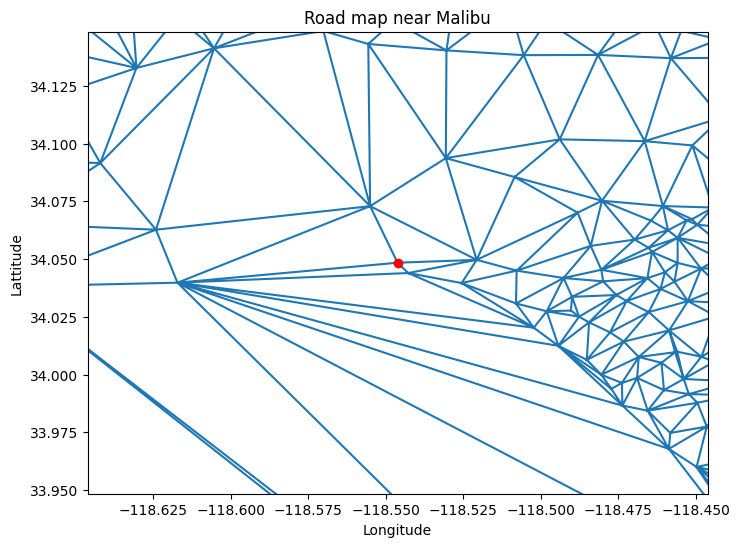

In [ ]:
plt.figure(figsize=(8, 6))
plt.triplot(gcc_v_coors[:, 0], gcc_v_coors[:, 1], tri.simplices.copy())
plt.plot(gcc_v_coors[malibu_idx][0], gcc_v_coors[malibu_idx][1],'o',color='red')
plt.title('Road map near Malibu')
plt.xlabel('Longitude')
plt.ylabel('Lattitude')
plt.xlim(gcc_v_coors[malibu_idx][0]-0.1, gcc_v_coors[malibu_idx][0]+0.1)
plt.ylim(gcc_v_coors[malibu_idx][1]-0.1, gcc_v_coors[malibu_idx][1]+0.1)
plt.show()

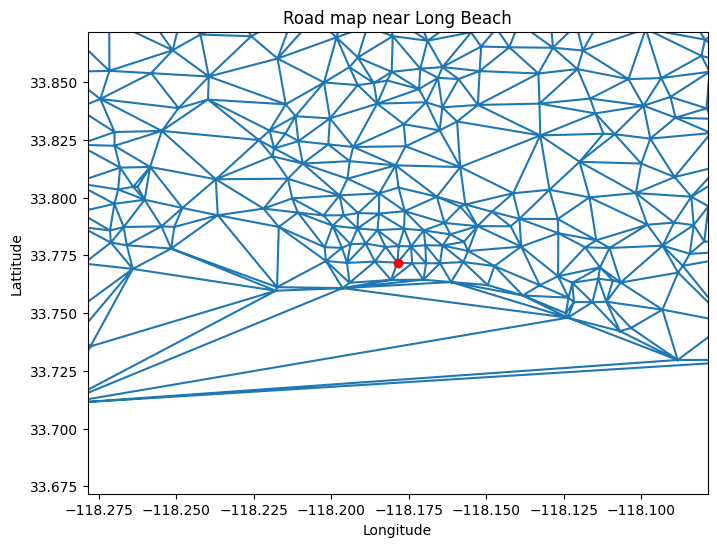

In [ ]:
plt.figure(figsize=(8, 6))
plt.triplot(gcc_v_coors[:, 0], gcc_v_coors[:, 1], tri.simplices.copy())
plt.plot(gcc_v_coors[long_beach_idx][0], gcc_v_coors[long_beach_idx][1],'o',color='red')
plt.title('Road map near Long Beach')
plt.xlabel('Longitude')
plt.ylabel('Lattitude')
plt.xlim(gcc_v_coors[long_beach_idx][0]-0.1, gcc_v_coors[long_beach_idx][0]+0.1)
plt.ylim(gcc_v_coors[long_beach_idx][1]-0.1, gcc_v_coors[long_beach_idx][1]+0.1)
plt.show()

<div class="alert alert-block alert-success">
<b>Answer 16:</b> The implementation results is shown above. the maximum number of cars that can commute per hour from Malibu to Long Beach based on the mean travel time of the average of all shortest paths is $3285 [\frac{\text{cars}}{\text{hour}}]$. Moreover, the number of edge-disjoint paths between the two spots is 4, which matches what one see on your road map. From the plots, one can see that there are in total 4 edges connect to the Malibu, and 6 to Long Beach, which matches the degree distribution of Malibu and Long Beach calculated above, respectively. Therefore, the number of edge-disjoint
paths is the minimum of the number of edges outgoing and incoming to each node, which in this case is exactly 4.
</div>

### 8. Prune Your Graph

<div class="alert alert-block alert-success">
<b>Question 17:</b> Plot $\tilde{G}_{\Delta}$ on actual coordinates. Do you think the thresholding method worked?
</div>

In [ ]:
# distance threshold in miles
dist_thr = 18

edge_to_delete = []
for i in range(len(tri.simplices)):
    pt1 = tri.points[tri.simplices[i][0]]
    pt2 = tri.points[tri.simplices[i][1]]
    pt3 = tri.points[tri.simplices[i][2]]

    d12 = np.sqrt((pt1[0]-pt2[0])**2+(pt1[1]-pt2[1])**2)*69
    d23 = np.sqrt((pt2[0]-pt3[0])**2+(pt2[1]-pt3[1])**2)*69
    d13 = np.sqrt((pt1[0]-pt3[0])**2+(pt1[1]-pt3[1])**2)*69

    if d12 > dist_thr:
        edge_to_delete.append((tri.simplices[i][0], tri.simplices[i][1]))
    if d23 > dist_thr:
        edge_to_delete.append((tri.simplices[i][1], tri.simplices[i][2]))
    if d13 > dist_thr:
        edge_to_delete.append((tri.simplices[i][0], tri.simplices[i][2]))

simplices_to_cut = []
for simplex in tri.simplices:
    for edge in edge_to_delete:
        if edge[0] in simplex and edge[1] in simplex:
            simplices_to_cut.append(list(simplex))

tri_simplices_prune = np.array([i for i in tri.simplices if i not in np.array(simplices_to_cut)])

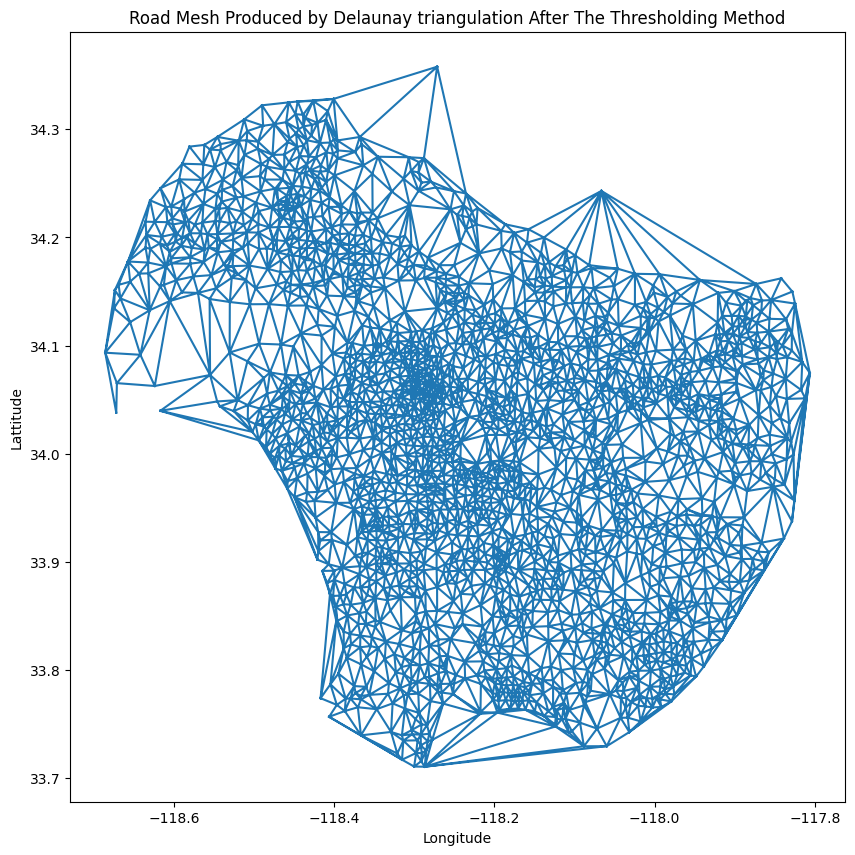

In [ ]:
plt.figure(figsize=(10,10))
plt.triplot(tri.points[:, 0],
            tri.points[:, 1], 
            tri_simplices_prune)
plt.title('Road Mesh Produced by Delaunay triangulation After The Thresholding Method')
plt.xlabel('Longitude')
plt.ylabel('Lattitude')
plt.show()

Create a grap $\tilde{G}_{\Delta}$

In [ ]:
edges_to_induce_prune = []

for i in range(tri_simplices_prune.shape[0]):
    for col1, col2 in ((0, 1), (1, 2), (0, 2)):
        # add the edges to edges_to_induce_prune
        try:
            edge = tuple(sorted((tri_simplices_prune[i][col1], tri_simplices_prune[i][col2])))
            e_id = g.get_eid(edge[0], edge[1])
            if edge not in edges_to_induce_prune:
                edges_to_induce_prune.append(edge)
        except:
            continue

In [ ]:
tri_g_prune = g.subgraph_edges(edges_to_induce_prune)
plot(tri_g_prune, **dict(vertex_size=3))

<div class="alert alert-block alert-success">
<b>Answer 17:</b> The results of the $\tilde{G}_{\Delta}$ and the road mesh are plotted above. Based on the road mesh, one can see that the thresholding method does work as the routes over the Topanga mountain and some unrealistic routes over the ocean have disappeared.
</div>

<div class="alert alert-block alert-success">
<b>Question 18:</b> Now, repeat question 16 for $\tilde{G}_{\Delta}$ and report the results. Do you see any changes? Why?
</div>

Degree Distribution of nodes (Malibu, Long Beach):  4 ,  6
Number of edge-disjoint paths (Malibu toLong Beach):  4
The maximum number of cars from Malibu to Long Beach: 3285


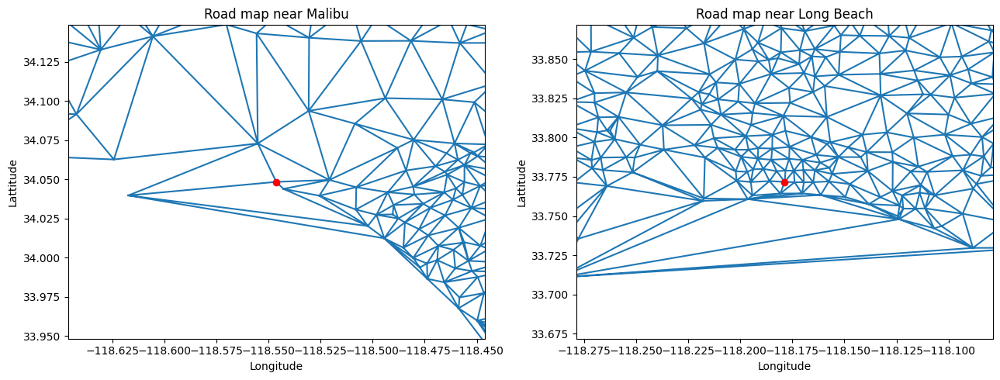

In [ ]:
'''
Use the given coordinate based on instruction - observe no change
'''
# malibu = [-118.5670548, 34.0458901]  # source_coordinates
# long_beach = [-118.1819374, 33.759958]  # dest_coordinates
malibu = [-118.56, 34.04]  # source_coordinates
long_beach = [-118.18, 33.77]  # dest_coordinates

min_long_beach = np.inf
min_malibu = np.inf
long_beach_idx = 0
malibu_idx = 0
gcc_v_coors = np.array([i["coordinates"] for i in g.vs])

for i in range(1,len(gcc_v_coors)):
    malibu_closest = np.sqrt((malibu[0]-gcc_v_coors[i][0])**2+(malibu[1]-gcc_v_coors[i][1])**2)
    if malibu_closest < min_malibu:
        min_malibu = malibu_closest
        malibu_idx = i

    long_beach_closest = np.sqrt(((gcc_v_coors[i][0])-long_beach[0])**2+((gcc_v_coors[i][1])-long_beach[1])**2)
    if long_beach_closest < min_long_beach:
        min_long_beach = long_beach_closest
        long_beach_idx = i
    

print('Degree Distribution of nodes (Malibu, Long Beach): ', 
      tri_g_prune.degree(malibu_idx,mode='out'), ", ", 
      tri_g_prune.degree(long_beach_idx,mode='in'))
print('Number of edge-disjoint paths (Malibu toLong Beach): ', tri_g_prune.adhesion(malibu_idx, long_beach_idx))

'''
Not sure what's the definition of the mean travel time. Should it be the average
of over all possible road paths or just the shortest paths.

Here, I calculate the mean travel time based on the average of all shortest paths
'''

def get_shortest_mmt(graph, src_idx, dst_idx):
    mtt = 0
    count = 0
    for path in graph.get_all_shortest_paths(src_idx, to=dst_idx):
        for i in range(len(path)-1):
            mtt += graph.es[graph.get_eid(path[i], path[i+1])]['weight']
            count += 1
    
    return mtt/count


mean_travel_time = get_shortest_mmt(g, malibu_idx, long_beach_idx)
vcar=(69*np.sqrt((malibu[0]-long_beach[0])**2+(malibu[1]-long_beach[1])**2))/(mean_travel_time/3600)
max_car_num=(3600*vcar)/(5.4 + vcar)
print("The maximum number of cars from Malibu to Long Beach:", int(max_car_num))

# plot
fig=plt.figure(figsize=(13, 5))

fig.add_subplot(1,2,1)
plt.triplot(gcc_v_coors[:, 0], gcc_v_coors[:, 1], tri_simplices_prune.copy())
plt.plot(gcc_v_coors[malibu_idx][0], gcc_v_coors[malibu_idx][1],'o',color='red')
plt.title('Road map near Malibu')
plt.xlabel('Longitude')
plt.ylabel('Lattitude')
plt.xlim(gcc_v_coors[malibu_idx][0]-0.1, gcc_v_coors[malibu_idx][0]+0.1)
plt.ylim(gcc_v_coors[malibu_idx][1]-0.1, gcc_v_coors[malibu_idx][1]+0.1)

fig.add_subplot(1,2,2)
plt.triplot(gcc_v_coors[:, 0], gcc_v_coors[:, 1], tri_simplices_prune.copy())
plt.plot(gcc_v_coors[long_beach_idx][0], gcc_v_coors[long_beach_idx][1],'o',color='red')
plt.title('Road map near Long Beach')
plt.xlabel('Longitude')
plt.ylabel('Lattitude')
plt.xlim(gcc_v_coors[long_beach_idx][0]-0.1, gcc_v_coors[long_beach_idx][0]+0.1)
plt.ylim(gcc_v_coors[long_beach_idx][1]-0.1, gcc_v_coors[long_beach_idx][1]+0.1)

plt.tight_layout()
plt.show()

Before Thresholding Method
Degree Distribution of nodes (Malibu, Long Beach):  4 ,  6
Number of edge-disjoint paths (Malibu toLong Beach):  4
- The maximum number of cars from Malibu to Long Beach: 3300

After Thresholding Method
- Degree Distribution of nodes (Malibu, Long Beach):  2 ,  6
- Number of edge-disjoint paths (Malibu toLong Beach):  2
- The maximum number of cars from Malibu to Long Beach: 3300



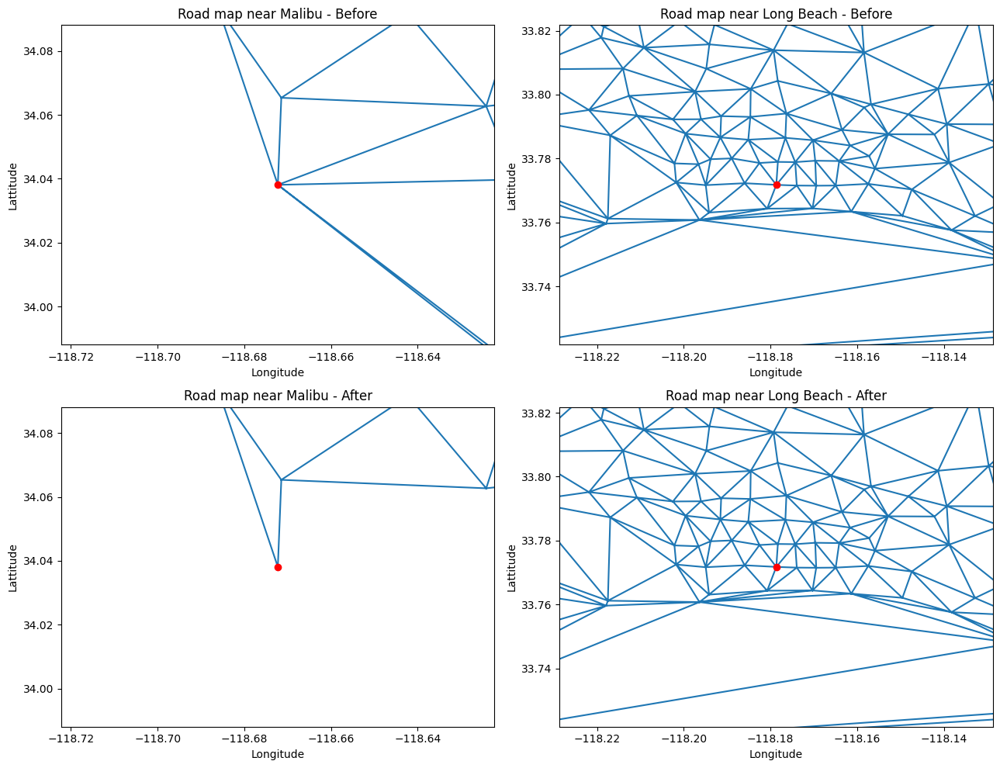

In [ ]:
'''
fine-tune the given coordinate - observe changes

Given:
- malibu = [-118.56, 34.04]  # source_coordinates
- long_beach = [-118.18, 33.77]  # dest_coordinates
'''

# fine-tune coordinate
malibu = [-118.67, 34.02]
long_beach = [-118.18, 33.77]

min_long_beach = np.inf
min_malibu = np.inf
long_beach_idx = 0
malibu_idx = 0
gcc_v_coors = np.array([i["coordinates"] for i in g.vs])

for i in range(1,len(gcc_v_coors)):
    malibu_closest = np.sqrt((malibu[0]-gcc_v_coors[i][0])**2+(malibu[1]-gcc_v_coors[i][1])**2)
    if malibu_closest < min_malibu:
        min_malibu = malibu_closest
        malibu_idx = i

    long_beach_closest = np.sqrt(((gcc_v_coors[i][0])-long_beach[0])**2+((gcc_v_coors[i][1])-long_beach[1])**2)
    if long_beach_closest < min_long_beach:
        min_long_beach = long_beach_closest
        long_beach_idx = i

print("Before Thresholding Method")
print('Degree Distribution of nodes (Malibu, Long Beach): ', 
      tri_g.degree(malibu_idx,mode='out'), ", ", 
      tri_g.degree(long_beach_idx,mode='in'))
print('Number of edge-disjoint paths (Malibu toLong Beach): ', tri_g.adhesion(malibu_idx, long_beach_idx))

mean_travel_time = get_shortest_mmt(g, malibu_idx, long_beach_idx)
vcar=(69*np.sqrt((malibu[0]-long_beach[0])**2+(malibu[1]-long_beach[1])**2))/(mean_travel_time/3600)
max_car_num=(3600*vcar)/(5.4 + vcar)
print("- The maximum number of cars from Malibu to Long Beach:", int(max_car_num))


print("\nAfter Thresholding Method")
print('- Degree Distribution of nodes (Malibu, Long Beach): ', 
      tri_g_prune.degree(malibu_idx,mode='out'), ", ", 
      tri_g_prune.degree(long_beach_idx,mode='in'))
print('- Number of edge-disjoint paths (Malibu toLong Beach): ', tri_g_prune.adhesion(malibu_idx, long_beach_idx))

mean_travel_time = get_shortest_mmt(g, malibu_idx, long_beach_idx)
vcar=(69*np.sqrt((malibu[0]-long_beach[0])**2+(malibu[1]-long_beach[1])**2))/(mean_travel_time/3600)
max_car_num=(3600*vcar)/(5.4 + vcar)
print("- The maximum number of cars from Malibu to Long Beach:", int(max_car_num))
print('')

# plot
fig=plt.figure(figsize=(13, 10))

fig.add_subplot(2,2,1)
plt.triplot(gcc_v_coors[:, 0], gcc_v_coors[:, 1], tri.simplices.copy())
plt.plot(gcc_v_coors[malibu_idx][0], gcc_v_coors[malibu_idx][1],'o',color='red')
plt.title('Road map near Malibu - Before')
plt.xlabel('Longitude')
plt.ylabel('Lattitude')
plt.xlim(gcc_v_coors[malibu_idx][0]-0.05, gcc_v_coors[malibu_idx][0]+0.05)
plt.ylim(gcc_v_coors[malibu_idx][1]-0.05, gcc_v_coors[malibu_idx][1]+0.05)

fig.add_subplot(2,2,2)
plt.triplot(gcc_v_coors[:, 0], gcc_v_coors[:, 1], tri.simplices.copy())
plt.plot(gcc_v_coors[long_beach_idx][0], gcc_v_coors[long_beach_idx][1],'o',color='red')
plt.title('Road map near Long Beach - Before')
plt.xlabel('Longitude')
plt.ylabel('Lattitude')
plt.xlim(gcc_v_coors[long_beach_idx][0]-0.05, gcc_v_coors[long_beach_idx][0]+0.05)
plt.ylim(gcc_v_coors[long_beach_idx][1]-0.05, gcc_v_coors[long_beach_idx][1]+0.05)

fig.add_subplot(2,2,3)
plt.triplot(gcc_v_coors[:, 0], gcc_v_coors[:, 1], tri_simplices_prune.copy())
plt.plot(gcc_v_coors[malibu_idx][0], gcc_v_coors[malibu_idx][1],'o',color='red')
plt.title('Road map near Malibu - After')
plt.xlabel('Longitude')
plt.ylabel('Lattitude')
plt.xlim(gcc_v_coors[malibu_idx][0]-0.05, gcc_v_coors[malibu_idx][0]+0.05)
plt.ylim(gcc_v_coors[malibu_idx][1]-0.05, gcc_v_coors[malibu_idx][1]+0.05)

fig.add_subplot(2,2,4)
plt.triplot(gcc_v_coors[:, 0], gcc_v_coors[:, 1], tri_simplices_prune.copy())
plt.plot(gcc_v_coors[long_beach_idx][0], gcc_v_coors[long_beach_idx][1],'o',color='red')
plt.title('Road map near Long Beach - After')
plt.xlabel('Longitude')
plt.ylabel('Lattitude')
plt.xlim(gcc_v_coors[long_beach_idx][0]-0.05, gcc_v_coors[long_beach_idx][0]+0.05)
plt.ylim(gcc_v_coors[long_beach_idx][1]-0.05, gcc_v_coors[long_beach_idx][1]+0.05)

plt.tight_layout()
plt.show()

<div class="alert alert-block alert-success">
<b>Answer 18:</b> The answer of this question depends on the chosen coordinate of Malibu. If we utilize the given coordinate in instruction, i.e. Malibu $= [-118.56, 34.04]$, then there is no change to be observed since the degree distribution of both nodes stays the same and thus the number of edge-disjoint paths stays also the same. However, if we fine-tune the coordinate of the Malibu a little bit, i.e. Malibu $= [-118.67, 34.02]$, one can see that the degree distribution of the node at Malibu reduces to 2 due to the disappearance of the routes over the Topanga mountain and some unrealistic routes over the ocean after the thresholding method. Therefore, the number of edge-disjoint paths and the maximum number of cars from Malibu to Long Beach also change accordingly.
</div>

### 9. Construct New Roads

Since there are two possible results of graph $\tilde{G}_{\Delta}$ based on the chosen coordinate of the Malibu, I pick the one where Malibu $= [-118.67, 34.02]$ at here due to the change of result in Q18 compared to the Q16.  

<div class="alert alert-block alert-success">
<b>Question 19:</b> Strategy 1 (geo distance, static): Reduce the maximum extra travelling distance. The extra travelling distance between 2 locations is the difference of the shortest traveling distance and the straight line distance. i.e. extra_distance(v,s) = distance_of_shortest_path(v,s) - euclidean_distance(v,s)

Use the coordinates of v and s to get the euclidean distance between them. Calculate the extra distance between all pairs of points. The top 20 pairs with highest extra distance will be the new edges we suggest. Print the source and destination of these pairs and write them in your report. Create these new edges in the graph, and plot the resultant graph on actual coordinates. What is
the time complexity of the strategy?
</div>

In [ ]:
road_map = deepcopy(tri_g_prune)
len(road_map.vs), len(road_map.es)

(2646, 7762)

In [ ]:
edge_ends = np.array([[e.source, e.target] for e in road_map.es])
sources, targets = edge_ends[:, 0], edge_ends[:, 1]
road_map_vs = np.array(road_map.vs['coordinates'])
distances = np.sqrt((road_map_vs[sources][:, 0] - road_map_vs[targets][:, 0])**2 + 
                    (road_map_vs[sources][:, 1] - road_map_vs[targets][:, 1])**2)
road_map.es['geo_distance'] = distances
vcount = len(road_map.vs)
max(distances)

0.13271902711268524

In [ ]:
'''
Method 1: use "graph.get_shortest_paths()" function
  Calculates the shortest paths from/to a given node in a graph.
  Return all nodes in the shortest path
'''
# shortest_path_distance = np.zeros((vcount, vcount))
# for i in range(vcount):
#     for j in range(i, vcount):
#         if i == j:
#             shortest_path_distance[i, j] = 0
#         else:
#             # <method 1>
#             paths_idx = road_map.get_shortest_paths(i, to=j, weights=road_map.es['geo_distance'])[0]
#             dist_sum = np.array(road_map.es['geo_distance'])[paths_idx].sum()
#             shortest_path_distance[i, j] = dist_sum
#             shortest_path_distance[j, i] = dist_sum

'''
Method 2: use "graph.shortest_paths()" function by looping through all pairs
  Calculates shortest path lengths for given vertices in a graph.
  Return the shortest path lengths
  
  The algorithm used for the calculations is selected automatically:
    a simple BFS is used for unweighted graphs, Dijkstra's algorithm is used 
    when all the weights are positive. Otherwise, the Bellman-Ford algorithm 
    is used if the number of requested source vertices is larger than 100 
    and Johnson's algorithm is used otherwise.
'''
# shortest_path_distance = np.zeros((vcount, vcount))
# for i in range(vcount):
#     for j in range(i, vcount):
#         if i == j:
#             shortest_path_distance[i, j] = 0
#         else:
#             dist_sum = road_map.shortest_paths(source=i, target=j, mode='all', 
#                                                weights=road_map.es['geo_distance'])[0][0]
#             shortest_path_distance[i, j] = dist_sum
#             shortest_path_distance[j, i] = dist_sum

'''
Method 3: use "graph.shortest_paths()" function 
  with a given list containing the source and targetvertex IDs
  
  The algorithm used for the calculations is selected automatically:
    a simple BFS is used for unweighted graphs, Dijkstra's algorithm is used 
    when all the weights are positive. Otherwise, the Bellman-Ford algorithm 
    is used if the number of requested source vertices is larger than 100 
    and Johnson's algorithm is used otherwise.
'''
shortest_path_distance = np.array(road_map.shortest_paths(source=np.arange(vcount), 
                                                          target=np.arange(vcount), 
                                                          weights=road_map.es['geo_distance'], 
                                                          mode='all'))

shortest_path_distance.shape

(2646, 2646)

In [ ]:
actual_geo_distances = np.zeros((vcount, vcount))
for i in range(vcount):
    for j in range(i, vcount):
        v1_coor = road_map.vs['coordinates'][i]
        v2_coor = road_map.vs['coordinates'][j]
        euclidean_dist = np.sqrt((v1_coor[0]-v2_coor[0])**2+(v1_coor[1]-v2_coor[1])**2)
        actual_geo_distances[i, j] = euclidean_dist
        actual_geo_distances[j, i] = euclidean_dist

In [ ]:
differences = shortest_path_distance - actual_geo_distances
differences.shape

(2646, 2646)

In [ ]:
k = 20
top_k = np.argsort(differences.reshape(-1))[::-1][::2][:k]

print("The top {} pairs with highest extra distance".format(k))
new_static_edges = []
for i in top_k:
    row, col = int(i//vcount), int(i%vcount)
    sort_edge = tuple(sorted((row, col)))
    new_static_edges.append(sort_edge)
    print("- Source, Destination: {}, Extra Distance: {:.5f}".format(sort_edge, differences[row, col]))

# new_static_edges

The top 20 pairs with highest extra distance
- Source, Destination: (2140, 2418), Extra Distance: 0.20474
- Source, Destination: (382, 2418), Extra Distance: 0.20195
- Source, Destination: (383, 2418), Extra Distance: 0.19896
- Source, Destination: (391, 2418), Extra Distance: 0.19730
- Source, Destination: (1901, 2418), Extra Distance: 0.19669
- Source, Destination: (381, 2418), Extra Distance: 0.19652
- Source, Destination: (2163, 2418), Extra Distance: 0.19515
- Source, Destination: (386, 2418), Extra Distance: 0.19462
- Source, Destination: (390, 2418), Extra Distance: 0.19458
- Source, Destination: (1904, 2418), Extra Distance: 0.19407
- Source, Destination: (45, 2418), Extra Distance: 0.19392
- Source, Destination: (1906, 2418), Extra Distance: 0.19391
- Source, Destination: (2158, 2418), Extra Distance: 0.19390
- Source, Destination: (1902, 2418), Extra Distance: 0.19386
- Source, Destination: (392, 2418), Extra Distance: 0.19370
- Source, Destination: (393, 2418), Extra Distanc

In [ ]:
# add the new_static_edges to our graph. 

road_map_static = deepcopy(tri_g_prune) #ensure to use deepcopy
for edg in new_static_edges:
    start = edg[0]
    end = edg[1]
    dist = actual_geo_distances[start, end]
    road_map_static.add_edge(start, end, geo_distance=dist)

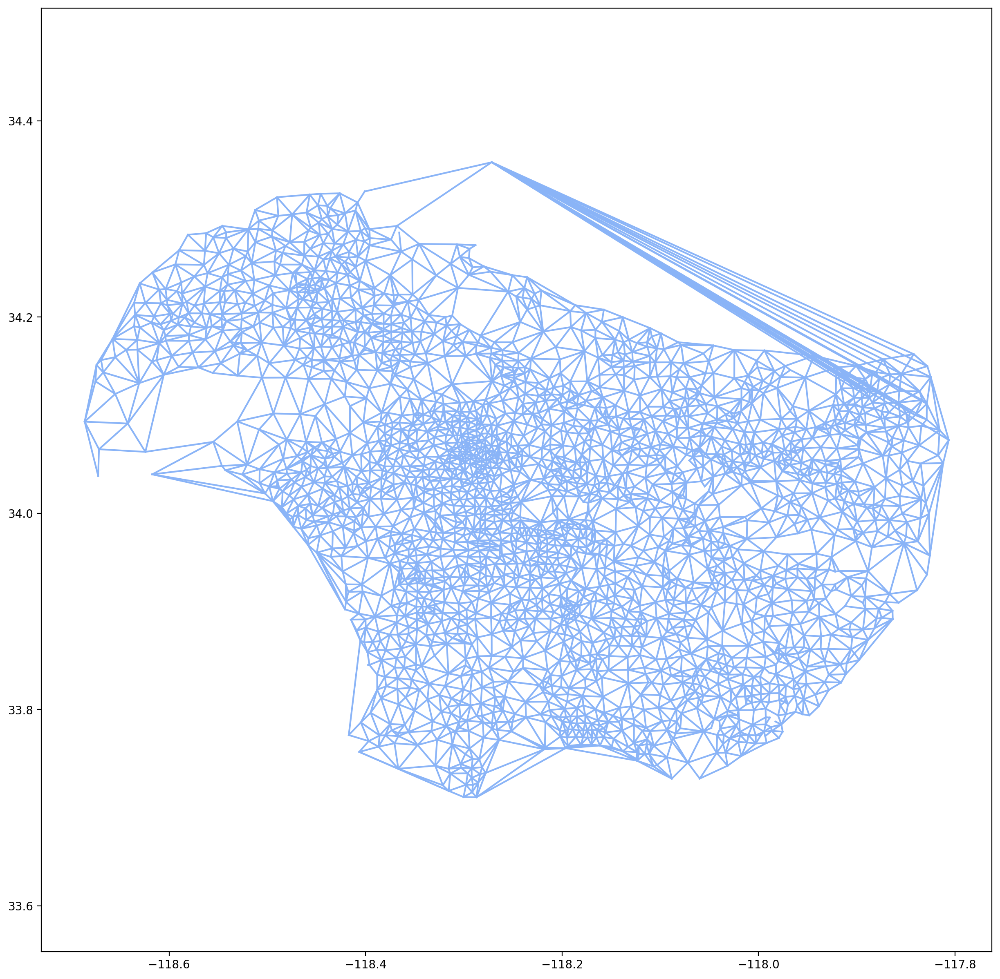

In [ ]:
# plot the roads and highlight our new edges. 
plt.figure(figsize=(15,15), dpi=200)
for e in road_map_static.es:
    start = e.source
    end = e.target
    cur_edge = sorted([start,end])

    v1 = road_map_static.vs[e.source]['coordinates']
    v2 = road_map_static.vs[e.target]['coordinates']
    data = np.vstack([v1, v2])
    x = data[:, 0]
    y = data[:, 1]
    if cur_edge in new_static_edges:
        print(cur_edge)
        plt.plot(x, y,'#FF0000') 
    else:
        plt.plot(x, y, '#8ab4f7')

plt.axis('equal')
plt.show()

<div class="alert alert-block alert-success">
<b>Answer 19:</b> The resultant graph on actual coordinates is illustrated above and the time complexity of this strategy is around $O(E \cdot \text{log} V)$ where $V$ is the number of vertices and $E$ is the total number of edges because the main time-consuming part at here is the Dijkstra's shortest path algorithm, which has a time complexity of $O(E \cdot \text{log} V)$. For the Substraction of receiving the final distance difference, the time complexity is supposed to be $O(V^{2})$. However, since it's implemented with numpy, which probably is programmed in C with time complexity of $O(V)$ or even faster. Therefore, it is ignorable compared to $O(E \cdot \text{log} V)$. The top 20 pairs with highest extra distance are the following:
<ul>
  <li>Source, Destination: (2140, 2418), Extra Distance: 0.20474</li>
  <li>Source, Destination: (382, 2418),  Extra Distance: 0.20195</li>
  <li>Source, Destination: (383, 2418),  Extra Distance: 0.19896</li>
  <li>Source, Destination: (391, 2418),  Extra Distance: 0.19730</li>
  <li>Source, Destination: (1901, 2418), Extra Distance: 0.19669</li>
  <li>Source, Destination: (381, 2418),  Extra Distance: 0.19652</li>
  <li>Source, Destination: (2163, 2418), Extra Distance: 0.19515</li>
  <li>Source, Destination: (386, 2418),  Extra Distance: 0.19462</li>
  <li>Source, Destination: (390, 2418),  Extra Distance: 0.19458</li>
  <li>Source, Destination: (1904, 2418), Extra Distance: 0.19407</li>
  <li>Source, Destination: (45, 2418),   Extra Distance: 0.19392</li>
  <li>Source, Destination: (1906, 2418), Extra Distance: 0.19391</li>
  <li>Source, Destination: (2158, 2418), Extra Distance: 0.19390</li>
  <li>Source, Destination: (1902, 2418), Extra Distance: 0.19386</li>
  <li>Source, Destination: (392, 2418),  Extra Distance: 0.19370</li>
  <li>Source, Destination: (393, 2418),  Extra Distance: 0.19369</li>
  <li>Source, Destination: (2159, 2418), Extra Distance: 0.19362</li>
  <li>Source, Destination: (48, 2418),   Extra Distance: 0.19355</li>
  <li>Source, Destination: (2162, 2418), Extra Distance: 0.19349</li>
  <li>Source, Destination: (47, 2418),   Extra Distance: 0.19336</li>
</ul>

</div>

<div class="alert alert-block alert-success">
<b>Question 20:</b> Strategy 2 (geo distance, static, with frequency): In strategy1, we are using the geographical distance between points to decide which new road to create. However, in the real world, some pairs are more in demand than other pairs. Assume that you know the frequency of travel between every pair. Use the frequency as the weight to multiply the difference. i.e.
weighted_extra_distance(v,s) = extra_distance(v,s) x frequency(v,s)
</div>

In [ ]:
np.random.seed(2022)
frequencies = np.random.randint(1, 1001, (vcount,vcount))
frequencies.shape

(2646, 2646)

In [ ]:
difference_frequency = np.multiply(differences, frequencies)

In [ ]:
k = 20
top_k = np.argsort(difference_frequency.reshape(-1))[::-1][::2][:k]

print("The top {} pairs with highest extra distance".format(k))
new_static_edges = []
for i in top_k:
    row, col = int(i//vcount), int(i%vcount)
    sort_edge = tuple(sorted((row, col)))
    new_static_edges.append(sort_edge)
    print("- Source, Destination: {}, Weighted Extra Distance: "\
          "{:.5f}".format(sort_edge, difference_frequency[row, col]))

The top 20 pairs with highest extra distance
- Source, Destination: (47, 2418), Weighted Extra Distance: 192.39530
- Source, Destination: (393, 2418), Weighted Extra Distance: 190.39247
- Source, Destination: (394, 2418), Weighted Extra Distance: 187.01942
- Source, Destination: (452, 2418), Weighted Extra Distance: 184.07887
- Source, Destination: (2171, 2418), Weighted Extra Distance: 183.52048
- Source, Destination: (2173, 2418), Weighted Extra Distance: 182.83703
- Source, Destination: (384, 2418), Weighted Extra Distance: 182.47690
- Source, Destination: (2156, 2418), Weighted Extra Distance: 179.17012
- Source, Destination: (2053, 2418), Weighted Extra Distance: 178.42716
- Source, Destination: (2146, 2418), Weighted Extra Distance: 177.57198
- Source, Destination: (2079, 2418), Weighted Extra Distance: 177.34854
- Source, Destination: (2222, 2418), Weighted Extra Distance: 177.18152
- Source, Destination: (386, 2418), Weighted Extra Distance: 176.91278
- Source, Destination: (21

In [ ]:
# add the new_static_edges to our graph. 
road_map_static = deepcopy(road_map) #ensure to use deepcopy
for edg in new_static_edges:
    start = edg[0]
    end = edg[1]
    dist = actual_geo_distances[start, end]
    road_map_static.add_edge(start, end, weight = dist)

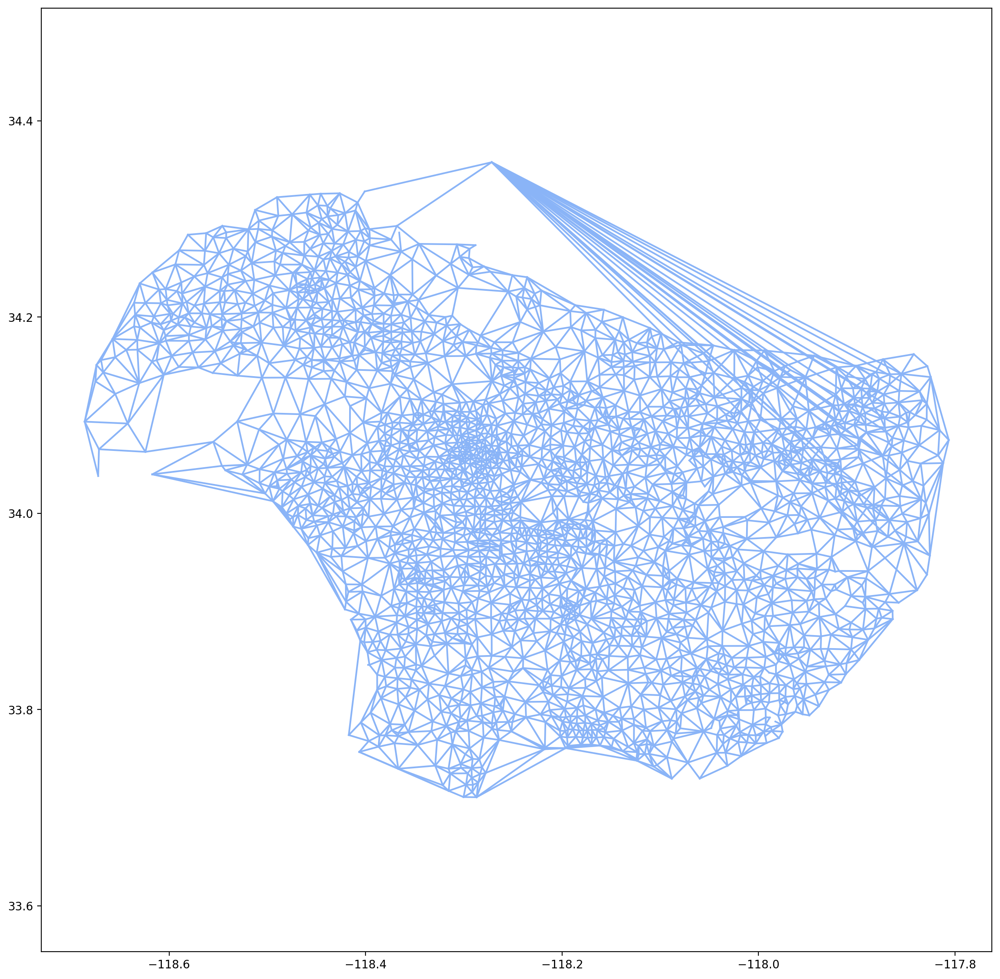

In [ ]:
# plot the roads and highlight our new edges. 
plt.figure(figsize=(15,15), dpi=200)
for e in road_map_static.es:
    start = e.source
    end = e.target
    cur_edge = sorted([start,end])

    v1 = road_map_static.vs[e.source]['coordinates']
    v2 = road_map_static.vs[e.target]['coordinates']
    data = np.vstack([v1, v2])
    x = data[:, 0]
    y = data[:, 1]
    if cur_edge in new_static_edges:
        print(cur_edge)
        plt.plot(x, y,'#FF0000') 
    else:
        plt.plot(x, y, '#8ab4f7')

plt.axis('equal')
plt.show()

<div class="alert alert-block alert-success">
<b>Answer 20:</b> The resultant graph on actual coordinates is illustrated above and similar to Q19, the time complexity of Dijkstra's shortest path algorithm is $O(E \cdot \text{log} V)$. However, this time, we have to multiply the distance difference matrix with the frequency matrix, which has a time complexity of $O(V^{2})$. Therefore, the total time complexity is $O(E \cdot \text{log} V ) + O(V^{2})$. The top 20 pairs with highest extra distance are the following:
<ul>
  <li>Source, Destination: (47, 2418), Weighted Extra Distance: 192.39530</li> 
  <li>Source, Destination: (393, 2418), Weighted Extra Distance: 190.39247</li>  
  <li>Source, Destination: (394, 2418), Weighted Extra Distance: 187.01942</li>  
  <li>Source, Destination: (452, 2418), Weighted Extra Distance: 184.07887</li>  
  <li>Source, Destination: (2171, 2418), Weighted Extra Distance: 183.52048</li>
  <li>Source, Destination: (2173, 2418), Weighted Extra Distance: 182.83703</li>
  <li>Source, Destination: (384, 2418), Weighted Extra Distance: 182.47690</li>  
  <li>Source, Destination: (2156, 2418), Weighted Extra Distance: 179.17012</li>
  <li>Source, Destination: (2053, 2418), Weighted Extra Distance: 178.42716</li>
  <li>Source, Destination: (2146, 2418), Weighted Extra Distance: 177.57198</li>
  <li>Source, Destination: (2079, 2418), Weighted Extra Distance: 177.34854</li>
  <li>Source, Destination: (2222, 2418), Weighted Extra Distance: 177.18152</li>
  <li>Source, Destination: (386, 2418), Weighted Extra Distance: 176.91278</li>  
  <li>Source, Destination: (2155, 2418), Weighted Extra Distance: 175.34277</li>
  <li>Source, Destination: (2191, 2418), Weighted Extra Distance: 175.01971</li>
  <li>Source, Destination: (2226, 2418), Weighted Extra Distance: 174.65783</li>
  <li>Source, Destination: (2418, 2471), Weighted Extra Distance: 173.87486</li>
  <li>Source, Destination: (53, 2418), Weighted Extra Distance: 173.45512</li>
  <li>Source, Destination: (390, 2418), Weighted Extra Distance: 172.78550</li>  
  <li>Source, Destination: (1956, 2418), Weighted Extra Distance: 172.23827</li>
</ul>

</div>

<div class="alert alert-block alert-success">
<b>Question 21:</b> Strategy 3 (geo distance, dynamic): In the above strategy, we are creating all roads at the same time. This time, we will create the roads one by one. Repeat 20 times: 

<ul>
  <li>i) Compute extra_distance between all the pairs in the graph.</li>
  <li>ii) Create a road between the pair with highest extra distance and update the graph.</li>
  <li>iii) Print the source and destination of this new edge.</li>
</ul>

Report the source and destination of the 20 new edges. plot the final graph on actual coordinates. What is the time complexity of the strategy?
</div>

In [ ]:
road_map_dynamic = deepcopy(road_map)
budget = 20
new_dynamic_edges = []

print("The top 20 pairs with highest extra distance")
for iter in range(budget):
    # get current graph shortest paths 
    cur_shortest_path_distance = road_map_dynamic.shortest_paths(source=np.arange(vcount), 
                                                                 target=np.arange(vcount), 
                                                                 weights=road_map_dynamic.es['geo_distance'], 
                                                                 mode='all')
    cur_shortest_path_distance = np.array(cur_shortest_path_distance)
    # get differences
    cur_diff = cur_shortest_path_distance - actual_geo_distances
    # sort differences and pich the highest
    top_1 = np.argsort(cur_diff.reshape(-1))[-1]
    # get vertices of new edge to build. Build the edge and print its vertices
    row, col = int(top_1//vcount), int(top_1%vcount)
    new_edge = tuple(sorted((row, col)))
    new_dynamic_edges.append(new_edge)
    print("- Source, Destination: {}, Extra Distance: {:.5f}".format(new_edge, cur_diff[row, col]))

    #add the new edge
    new_distance = actual_geo_distances[row, col]
    road_map_dynamic.add_edge(row, col, weight=-1 , geo_distance=new_distance)

The top 20 pairs with highest extra distance
- Source, Destination: (2140, 2418), Extra Distance: 0.20474
- Source, Destination: (285, 2418), Extra Distance: 0.19004
- Source, Destination: (1956, 2418), Extra Distance: 0.17665
- Source, Destination: (2241, 2418), Extra Distance: 0.16490
- Source, Destination: (1699, 1700), Extra Distance: 0.15982
- Source, Destination: (509, 2418), Extra Distance: 0.14485
- Source, Destination: (1684, 2418), Extra Distance: 0.11692
- Source, Destination: (1700, 2417), Extra Distance: 0.10567
- Source, Destination: (985, 1860), Extra Distance: 0.09794
- Source, Destination: (1699, 1860), Extra Distance: 0.09577
- Source, Destination: (1783, 2411), Extra Distance: 0.08951
- Source, Destination: (989, 1510), Extra Distance: 0.08380
- Source, Destination: (430, 2618), Extra Distance: 0.07732
- Source, Destination: (1860, 2417), Extra Distance: 0.07624
- Source, Destination: (144, 2618), Extra Distance: 0.07009
- Source, Destination: (1700, 1783), Extra Dis

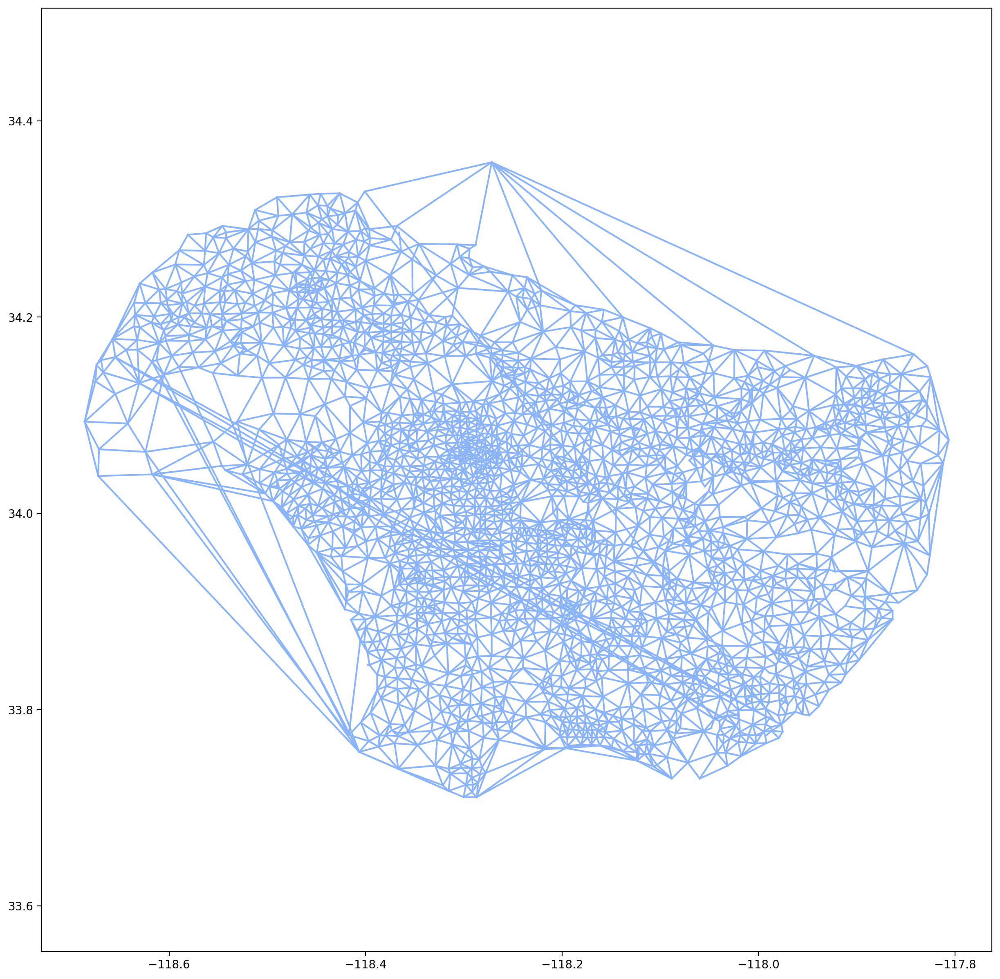

In [ ]:
# plot the roads
plt.figure(figsize=(15,15), dpi=200)
for e in road_map_dynamic.es:
    start = e.source
    end = e.target
    cur_edge = sorted([start,end])

    v1 = road_map_dynamic.vs[e.source]['coordinates']
    v2 = road_map_dynamic.vs[e.target]['coordinates']
    data = np.vstack([v1, v2])
    x = data[:, 0]
    y = data[:, 1]
    if cur_edge in new_dynamic_edges:
        print(cur_edge)
        plt.plot(x, y, '#FF0000')
    else:
        plt.plot(x, y, '#8ab4f7')

plt.axis('equal')
plt.show()

<div class="alert alert-block alert-success">
<b>Answer 21:</b> The final graph on actual coordinates in shown above. The time complexity of this alogrithm is around $O(N \cdot E \text{log} V)$, where $N$ is the number of repeat. The top 20 pairs with highest extra distance are the following:
<ul>
  <li>Source, Destination: (2140, 2418), Extra Distance: 0.20474</li>
  <li>Source, Destination: (285, 2418), Extra Distance: 0.19004</li>
  <li>Source, Destination: (1956, 2418), Extra Distance: 0.17665</li>
  <li>Source, Destination: (2241, 2418), Extra Distance: 0.16490</li>
  <li>Source, Destination: (1699, 1700), Extra Distance: 0.15982</li>
  <li>Source, Destination: (509, 2418), Extra Distance: 0.14485</li>
  <li>Source, Destination: (1684, 2418), Extra Distance: 0.11692</li>
  <li>Source, Destination: (1700, 2417), Extra Distance: 0.10567</li>
  <li>Source, Destination: (985, 1860), Extra Distance: 0.09794</li>
  <li>Source, Destination: (1699, 1860), Extra Distance: 0.09577</li>
  <li>Source, Destination: (1783, 2411), Extra Distance: 0.08951</li>
  <li>Source, Destination: (989, 1510), Extra Distance: 0.08380</li>
  <li>Source, Destination: (430, 2618), Extra Distance: 0.07732</li>
  <li>Source, Destination: (1860, 2417), Extra Distance: 0.07624</li>
  <li>Source, Destination: (144, 2618), Extra Distance: 0.07009</li>
  <li>Source, Destination: (1700, 1783), Extra Distance: 0.06700</li>
  <li>Source, Destination: (430, 2558), Extra Distance: 0.06657</li>
  <li>Source, Destination: (144, 2558), Extra Distance: 0.06551</li>
  <li>Source, Destination: (2128, 2618), Extra Distance: 0.06456</li>
  <li>Source, Destination: (1005, 1860), Extra Distance: 0.06455</li>
</ul>
</div>

<div class="alert alert-block alert-success">
<b>Question 22:</b> Strategy 4 (Travel time, static): We want to optimize to reduce the maximum extra travelling time. The extra travelling distance between 2 locations is the difference of the shortest traveling time and the straight line travel time. i.e. 
<ul>
  <li>extra_time(v,s) = travel_time_of_shortest_path(v,s) - euclidean_distance(v,s)/travel_speed(v,s)</li>
  <li>travel_speed(v,s) = distance_of_shortest_path(v,s) / travel_time_of_shortest_path(v,s)</li>
</ul>

Use the coordinates of v and s to get the euclidean distance between them. Calculate the extra time between all pairs of points. The top 20 pairs with highest extra time will be the new edges we suggest. Print the source and destination of these pairs and write them in your report. Create these new
edges in the graph, and plot the resultant graph on actual coordinates. What is the time complexity of the strategy? What is the time complexity of the strategy?
</div>

In [ ]:
road_map_time = deepcopy(road_map)

In [ ]:
actual_geo_distances = np.zeros((vcount, vcount))
for i in range(vcount):
    for j in range(i, vcount):
        v1_coor = road_map_time.vs['coordinates'][i]
        v2_coor = road_map_time.vs['coordinates'][j]
        euclidean_dist = np.sqrt((v1_coor[0]-v2_coor[0])**2+(v1_coor[1]-v2_coor[1])**2)
        actual_geo_distances[i, j] = euclidean_dist
        actual_geo_distances[j, i] = euclidean_dist

In [ ]:
# get the shortest time
current_shortest_time = road_map_time.shortest_paths(source=np.arange(vcount), 
                                                     target=np.arange(vcount), 
                                                     weights=road_map_time.es['weight'], 
                                                     mode='all')
current_shortest_time = np.array(current_shortest_time) / 60 / 60 # convert unit to [hr]

shortest_paths = road_map_time.shortest_paths(source=np.arange(vcount), 
                                              target=np.arange(vcount), 
                                              weights=road_map_time.es['geo_distance'], 
                                              mode='all')
shortest_paths = np.array(shortest_paths) * 69 # convert unit to [miles]
actual_geo_distances = np.array(actual_geo_distances) * 69 # convert unit to [miles]

current_speed = np.nan_to_num(shortest_paths / current_shortest_time) # unit in [miles/hr]

In [ ]:
# compute extra time
time_diffence = current_shortest_time - np.nan_to_num(actual_geo_distances/current_speed)

In [ ]:
k = 20
top_k = np.argsort(time_diffence.reshape(-1))[::-1][::2][:k]

print("The top {} pairs with highest extra time".format(k))
new_time_edges = []
for i in top_k:
    row, col = int(i//vcount), int(i%vcount)
    sort_edge = tuple(sorted((row, col)))
    new_time_edges.append(sort_edge)
    print("- Source, Destination: {}, Extra Time: {:.5f} hr".format(sort_edge, 
                                                                    time_diffence[row, col]))

The top 20 pairs with highest extra time
- Source, Destination: (1699, 1700), Extra Time: 0.61056 hr
- Source, Destination: (1699, 1860), Extra Time: 0.53256 hr
- Source, Destination: (1699, 1783), Extra Time: 0.49601 hr
- Source, Destination: (1699, 1859), Extra Time: 0.48273 hr
- Source, Destination: (1699, 1782), Extra Time: 0.46548 hr
- Source, Destination: (1700, 2416), Extra Time: 0.45792 hr
- Source, Destination: (1699, 1882), Extra Time: 0.44822 hr
- Source, Destination: (1699, 1857), Extra Time: 0.43570 hr
- Source, Destination: (2144, 2418), Extra Time: 0.43050 hr
- Source, Destination: (2052, 2418), Extra Time: 0.42573 hr
- Source, Destination: (2051, 2418), Extra Time: 0.42348 hr
- Source, Destination: (2150, 2418), Extra Time: 0.42276 hr
- Source, Destination: (1699, 1861), Extra Time: 0.42198 hr
- Source, Destination: (1901, 2418), Extra Time: 0.42049 hr
- Source, Destination: (1904, 2418), Extra Time: 0.42004 hr
- Source, Destination: (382, 2418), Extra Time: 0.41971 hr


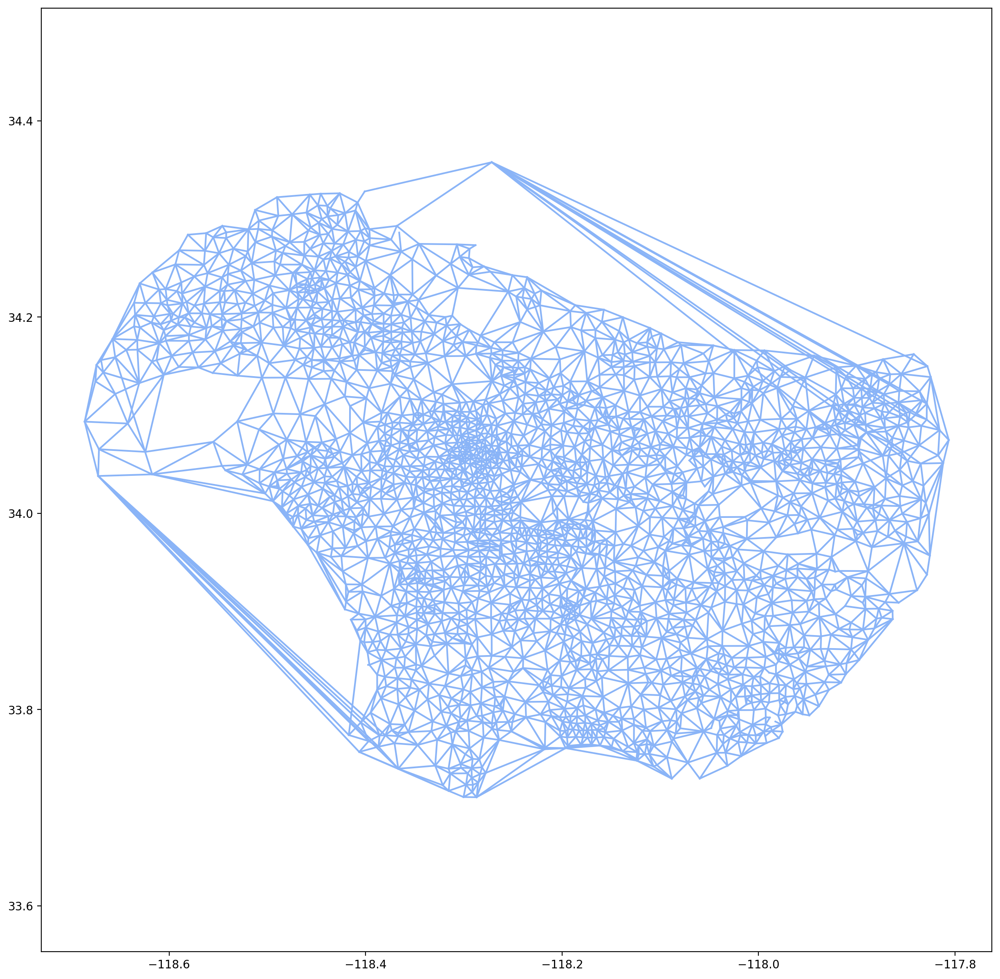

In [ ]:
# add the new_time_edges to our graph. 
road_map_time_static = deepcopy(road_map_time) #ensure to use deepcopy
for edg in new_time_edges:
    start = edg[0]
    end = edg[1]
    dist = actual_geo_distances[start, end] / 69
    w = current_shortest_time[start, end] * 60 * 60
    road_map_time_static.add_edge(start, end, weight=w, geo_distance=dist)

# plot the roads and highlight our new edges. 
plt.figure(figsize=(15,15), dpi=200)
for e in road_map_time_static.es:
    start = e.source
    end = e.target
    cur_edge = sorted([start,end])

    v1 = road_map_time_static.vs[e.source]['coordinates']
    v2 = road_map_time_static.vs[e.target]['coordinates']
    data = np.vstack([v1, v2])
    x = data[:, 0]
    y = data[:, 1]
    if cur_edge in new_time_edges:
        print(cur_edge)
        plt.plot(x, y,'#FF0000') 
    else:
        plt.plot(x, y, '#8ab4f7')

plt.axis('equal')
plt.show()

<div class="alert alert-block alert-success">
<b>Answer 22:</b> The resultant graph on actual coordinates is illustrated above and the time complexity of this strategy is around $O(2 \cdot E \text{log} V) + O(V^{2})$ where $V$ is the number of vertices and $E$ is the total number of edges. The reason for this is that we have to apply Dijkstra's shortest path algorithm 2 times to find the shortest path and shortest_time, which results in a time complexity of $O(2 \cdot E \text{log} V)$, and we also have to compute the travel speed by dividing the shortest path by the shortest_time, which has a time complexity of $O(V^{2})$. The top 20 pairs with highest extra distance are the following:
<ul>
  <li>Source, Destination: (1699, 1700), Extra Time: 0.61056 hr</li>
  <li>Source, Destination: (1699, 1860), Extra Time: 0.53256 hr</li>
  <li>Source, Destination: (1699, 1783), Extra Time: 0.49601 hr</li>
  <li>Source, Destination: (1699, 1859), Extra Time: 0.48273 hr</li>
  <li>Source, Destination: (1699, 1782), Extra Time: 0.46548 hr</li>
  <li>Source, Destination: (1700, 2416), Extra Time: 0.45792 hr</li>
  <li>Source, Destination: (1699, 1882), Extra Time: 0.44822 hr</li>
  <li>Source, Destination: (1699, 1857), Extra Time: 0.43570 hr</li>
  <li>Source, Destination: (2144, 2418), Extra Time: 0.43050 hr</li>
  <li>Source, Destination: (2052, 2418), Extra Time: 0.42573 hr</li>
  <li>Source, Destination: (2051, 2418), Extra Time: 0.42348 hr</li>
  <li>Source, Destination: (2150, 2418), Extra Time: 0.42276 hr</li>
  <li>Source, Destination: (1699, 1861), Extra Time: 0.42198 hr</li>
  <li>Source, Destination: (1901, 2418), Extra Time: 0.42049 hr</li>
  <li>Source, Destination: (1904, 2418), Extra Time: 0.42004 hr</li>
  <li>Source, Destination: (382, 2418), Extra Time: 0.41971 hr</li>
  <li>Source, Destination: (430, 1700), Extra Time: 0.41959 hr</li>
  <li>Source, Destination: (389, 2418), Extra Time: 0.41952 hr</li>
  <li>Source, Destination: (1699, 1881), Extra Time: 0.41942 hr</li>
  <li>Source, Destination: (225, 2418), Extra Time: 0.41930 hr</li>
</ul>

</div>

<div class="alert alert-block alert-success">
<b>Question 23:</b> Strategy 5 (Travel time, dynamic): Similar to strategy 3, this time we will create roads one by one while optimizing the travel time. Repeat 20 times: 

<ul>
  <li>i) Compute extra_time between all the pairs in the graph.</li>
  <li>ii) Create a road between the pair with highest extra time and update the graph.</li>
  <li>iii) Print the source and destination of this new edge.</li>
</ul>

Report the source and destination of the 20 new edges. plot the final graph on actual coordinates. What is the time complexity of the strategy?
</div>

In [ ]:
road_map_time_dynamic = deepcopy(road_map)

In [ ]:
actual_geo_distances = np.zeros((vcount, vcount))
for i in range(vcount):
    for j in range(i, vcount):
        v1_coor = road_map_time.vs['coordinates'][i]
        v2_coor = road_map_time.vs['coordinates'][j]
        euclidean_dist = np.sqrt((v1_coor[0]-v2_coor[0])**2+(v1_coor[1]-v2_coor[1])**2)
        actual_geo_distances[i, j] = euclidean_dist
        actual_geo_distances[j, i] = euclidean_dist

In [ ]:
budget = 20
new_dynamic_time_edges = []

print("The top 20 pairs with highest extra time:")
for iter in range(budget):
    # get the shortest time
    current_shortest_time = road_map_time_dynamic.shortest_paths(source=np.arange(vcount), 
                                                                 target=np.arange(vcount), 
                                                                 weights=road_map_time_dynamic.es['weight'], 
                                                                 mode='all')
    current_shortest_time = np.array(current_shortest_time)

    shortest_paths = road_map_time_dynamic.shortest_paths(source=np.arange(vcount), 
                                                          target=np.arange(vcount), 
                                                          weights=road_map_time_dynamic.es['geo_distance'], 
                                                          mode='all')
    shortest_paths = np.array(shortest_paths)
    actual_geo_distances = np.array(actual_geo_distances)

    # compute the speed in unit [miles/hr]
    current_speed = np.nan_to_num((shortest_paths*69)/(current_shortest_time/60/60))

    # compute extra time in unit [hr]
    time_diffence = (current_shortest_time/60/60) - np.nan_to_num(actual_geo_distances*69/current_speed)

    top_1 = np.argsort(time_diffence.reshape(-1))[-1]

    # get vertices of new edge to build. Build the edge and print its vertices
    row, col = int(top_1//vcount), int(top_1%vcount)
    new_edge = tuple(sorted((row, col)))
    new_dynamic_time_edges.append(new_edge)
    print("- Source, Destination: {}, Extra Time: {:.5f}".format(new_edge, time_diffence[row, col]))

    #add the new edge
    dist = actual_geo_distances[row, col]
    w = current_shortest_time[row, col]
    road_map_time_dynamic.add_edge(row, col, weight=w , geo_distance=dist)

The top 20 pairs with highest extra time:
- Source, Destination: (1699, 1700), Extra Time: 0.61056
- Source, Destination: (2144, 2418), Extra Time: 0.43050
- Source, Destination: (2418, 2634), Extra Time: 0.40086
- Source, Destination: (2072, 2418), Extra Time: 0.39170
- Source, Destination: (1699, 1860), Extra Time: 0.37998
- Source, Destination: (311, 2418), Extra Time: 0.36396
- Source, Destination: (22, 2418), Extra Time: 0.32931
- Source, Destination: (988, 1700), Extra Time: 0.32361
- Source, Destination: (2248, 2418), Extra Time: 0.30973
- Source, Destination: (1700, 2417), Extra Time: 0.30452
- Source, Destination: (989, 1510), Extra Time: 0.27611
- Source, Destination: (507, 2418), Extra Time: 0.27074
- Source, Destination: (1699, 1781), Extra Time: 0.25922
- Source, Destination: (1860, 2417), Extra Time: 0.25646
- Source, Destination: (144, 1783), Extra Time: 0.21558
- Source, Destination: (1700, 1783), Extra Time: 0.21119
- Source, Destination: (988, 1678), Extra Time: 0.209

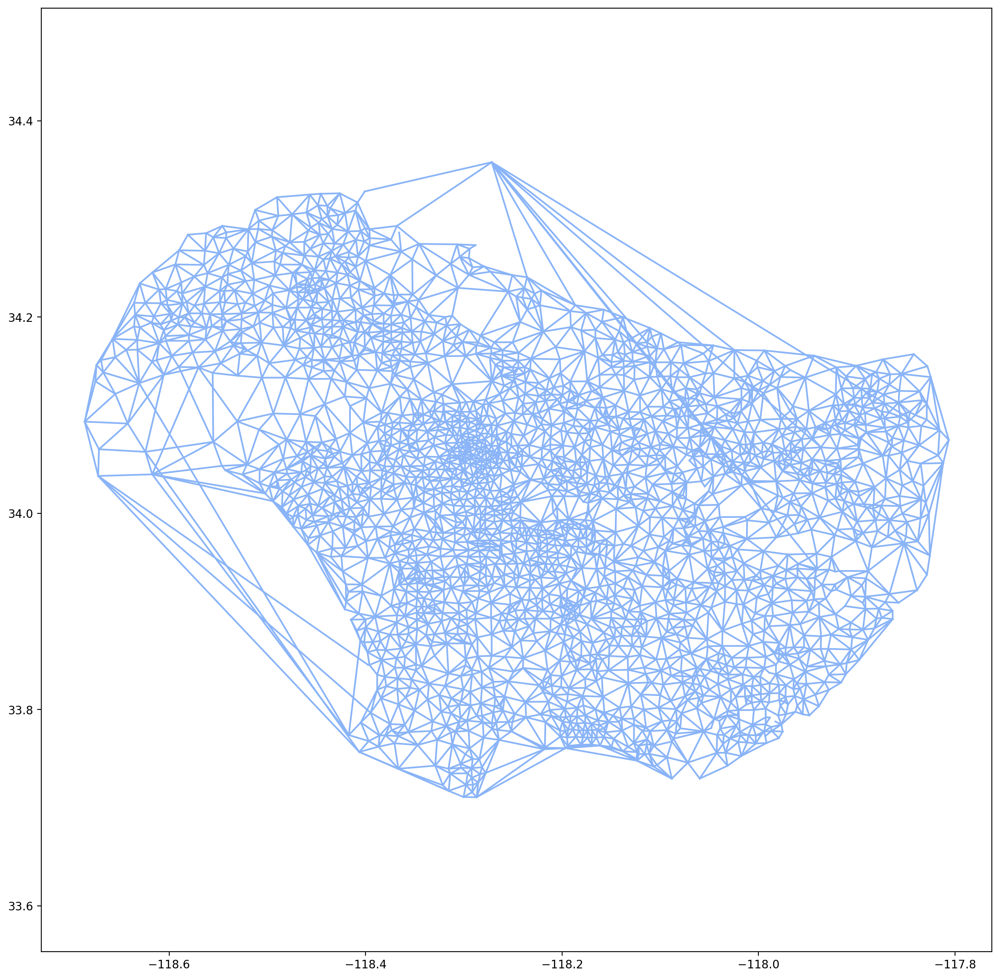

In [ ]:
# plot the roads
plt.figure(figsize=(15,15), dpi=200)
for e in road_map_time_dynamic.es:
    start = e.source
    end = e.target
    cur_edge = sorted([start,end])

    v1 = road_map_time_dynamic.vs[e.source]['coordinates']
    v2 = road_map_time_dynamic.vs[e.target]['coordinates']
    data = np.vstack([v1, v2])
    x = data[:, 0]
    y = data[:, 1]
    if cur_edge in new_dynamic_time_edges:
        print(cur_edge)
        plt.plot(x, y, '#FF0000')
    else:
        plt.plot(x, y, '#8ab4f7')

plt.axis('equal')
plt.show()

<div class="alert alert-block alert-success">
<b>Answer 23:</b> The final graph on actual coordinates in shown above. The time complexity of this alogrithm is around $O(N \cdot 2 \cdot E \text{log} V) + O(N \cdot V^{2})$, where $N$ is the number of repeat. The top 20 pairs with highest extra distance are the following:
<ul>
  <li>Source, Destination: (1699, 1700), Extra Time: 0.61056 hr</li>
  <li>Source, Destination: (2144, 2418), Extra Time: 0.43050 hr</li>
  <li>Source, Destination: (2418, 2634), Extra Time: 0.40086 hr</li>
  <li>Source, Destination: (2072, 2418), Extra Time: 0.39170 hr</li>
  <li>Source, Destination: (1699, 1860), Extra Time: 0.37998 hr</li>
  <li>Source, Destination: (311, 2418), Extra Time: 0.36396 hr</li>
  <li>Source, Destination: (22, 2418), Extra Time: 0.32931 hr</li>
  <li>Source, Destination: (988, 1700), Extra Time: 0.32361 hr</li>
  <li>Source, Destination: (2248, 2418), Extra Time: 0.30973 hr</li>
  <li>Source, Destination: (1700, 2417), Extra Time: 0.30452 hr</li>
  <li>Source, Destination: (989, 1510), Extra Time: 0.27611 hr</li>
  <li>Source, Destination: (507, 2418), Extra Time: 0.27074 hr</li>
  <li>Source, Destination: (1699, 1781), Extra Time: 0.25922 hr</li>
  <li>Source, Destination: (1860, 2417), Extra Time: 0.25646 hr</li>
  <li>Source, Destination: (144, 1783), Extra Time: 0.21558 hr</li>
  <li>Source, Destination: (1700, 1783), Extra Time: 0.21119 hr</li>
  <li>Source, Destination: (988, 1678), Extra Time: 0.20903 hr</li>
  <li>Source, Destination: (2135, 2418), Extra Time: 0.19896 hr</li>
  <li>Source, Destination: (1699, 2402), Extra Time: 0.19655 hr</li>
  <li>Source, Destination: (1005, 1510), Extra Time: 0.18877 hr</li>
</ul>
</div>

<div class="alert alert-block alert-success">
<b>Question 24:</b> Strategy comparison. Compare the following strategies:
<ul>
  <li>a) 1 vs 2 - compare and analyze the results. which is better? why?</li>
  <li>b) 1 vs 3 - compare and analyze the results. which is better? why?</li>
  <li>c) 1 vs 4 - compare and analyze the results. which is better? why?</li>
  <li>d) statics vs dynamic - Considering we want to improve the overall road network by constructing new roads, is either of them the optimal strategy?</li>
  <ul>
    <li>i) if yes, which one and why?</li>
    <li>ii) if not, what would be a better strategy to construct roads and is it optimal? What is the time complexity?</li> 
    <li>(assume that you want to reduce travelling distances and you know before hand that we have to construct 20 new roads).</li> 
  </ul>
  <li>e) Open ended question : Come up with new strategy. You are free to make any assumptions. You don't have to necessarily optimize traveling time or distance, you can come up with any constraints. justify your strategy.</li>
</ul>

</div>

<div class="alert alert-block alert-success">
<b>Answer 24:</b> 
<ul>
  <li>a) There isn't a huge difference between the result of strategy 1 and 2 according to the plots shown above. Basically, most of the new edges we suggest are related to the node 2418 and connects to other nodes, which is mostly on the other side across the mountain area. However, after a closer look, one can notice that with strategy 2, those nodes besides the node 2418 spread wider to different areas/cities. Hence, we can say that strategy 2 is better compared to strategy 1 as the 20 new edges generated through this method spread to more area, which is in general better than having 20 new edges connects same area.</li>
  <li>b) It is obvious that the strategy 3 is hugely better than the strategy 1. From the plots, one can see that with strategy 3, the 20 new generated roads successfully connect various different areas and cities, unlike strategy 1 which mostly connects to 2418 in the mountain area. We can see that there are new roads like highways that directly connect cities across the ocean, mountain area, and north-west side of LA to south-east side of LA. This high variaty of connection will definitely benefit the city more that the suggestion roads generated by strategy 1. Moreover, from the reported value of extra distance generated at the end of each algorithm, we can see that after strategy 3, the maximal extra distance is only $0.06455 \times 69=4.45395 \text{ miles}$, which is way smaller than the maximal extra distance after strategy 1, which is  $0.19336 \times 69=13.34184 \text{ miles}$. Therefore, strategy 3 is better.</li>
  <li>c) Based on the plots, we can see that the strategy 4 is better than the strategy 1 as it regonizes not only the need of new roads to directly connect the mountain area (node 2418) to other cities on the other side of the mountain but also the better direct solution to travel from Malibu to other cities by building high ways across the ocean to reduce the total time to travel from any point in LA to another point.</li>
  <li>Generally speaking, dynamic strategy is better than statics strategy if we considering the improvement of the overall road network by constructing new roads, which can be proven based on both maximal extra distance (dynamic vs. statics: 4.45 miles vs. 13.34 miles) or maximal extra time (dynamic vs. statics: 0.19 hr vs. 0.42 hr) after 20 new roads construction. However, even though the dynamic strategy is better, it is not the optimal strategy because it doesn't consider the reality of such construction such as the cost, safety, feasibility, time, etc. A better strategy would be to take all of the aforemention reality factors in to consideration. However, this will results in a very high time complexity at least $O(N \cdot M \cdot E \text{log} V)$ where $N$ is the number of new road to construct and $M$ is the number of reality factors that we need to use Dijkstra's shortest path algorithm $O( E \text{log} V)$ to find the optimal value. $V$ is the number of vertices and $E$ is the total number of edges. If there is further calculation needed such as computing the weights beteen each factor or other mathematical formulation, than the time complexity will even incease to higher value. For example, adding matrix multiplicantion at the end of each road construction decision will result in increasing the time complexity by $O(N \cdot V^{2})$.</li>
  <li>e) An intuitive idea is to dynamic strategy to optimize between the pros and cons of constructing the new road. The pros are, for instance, less time and distance to travel and the cons are the cost of such road such as time to construct and money. In order to optimize this, we have to come up an objective funcntion that combine both pros and cons in some mathematical formulation or some weight factors to balance the importantness among each factor. Other constraints might also need to be introduce to make such decision of construction feasible. With such an idea and algorithm, I think we can find the optimal road to construct.</li>
</ul>

</div>

## 10. Define Your Own Task

<div class="alert alert-block alert-success">
<b>Define Your Own Task:</b> 
<ul></ul>
Over the past two years, the COVID-19 pandemic has had a significant and profound impact on our lives. The resulting environmental changes have compelled numerous individuals to adapt their daily routines and work patterns. Unfortunately, among those most severely affected by these circumstances are the proprietors of local shops, restaurants, and small-scale stores or businesses. Many of them have been compelled to temporarily close their operations or undertake a digital transformation to offer delivery services for food and other items, in order to sustain their businesses during these challenging times. Therefore, in this task, I would like to help the proprietors in Seattle to optimize the time of their delivery by suggesting the best routes to transport with minimal time and the optimal number of needed delivery men to hire for such service under the condition of limited maximal number of workers the proprietors can hire and the limited delivery capacity of a person per delivery. With such help, the proprietors in Seattle can reduce the cost of their business and maximize the benefits in order to survive during the COVID-19 pandemic.
<ul></ul>
Considering the following simplified scenario: A random store ($S$) in Seattle receives a different amount of orders, which is generally under 5, from an average of 10 other customers ($C$) in random locations in Seattle per day. The maximum number of delivery men ($k \in K$) the proprietor can afford to pay is 10 people and the maximum delivery capacity ($O$) per person is $8$ orders. Given is the graph of the Seattle city where each node ($V$) corresponds to a location and each edge ($E$ or $e_{ij}$) represents the road between the pair of the nodes with a weight $t_{ij}$ corresponding to the mean average time to travel of that road. With this description, we can formulate this problem as a linear programming problem (LP) by introducing the following objective function as well as constraints, and we can solve the LP formulation to find out the optimal number of workers to hire and the optimal delivery time with the optimal routes.

<ul>
  <li>The objective function to minimize the delivery time: $min \sum_{k \in K} \sum_{(i,j) \in E} t_{ij}x_{ij}^{k}$, where $t_{ij}$ denotes the weight of the edge, which corresponds to the mean average travel time, and $x_{ij}^{k} = \begin{cases} 1, & \text{if the route } e_{ij} \text{ is selected by the delivery man } k \\ 0, & \text{otherwise} \end{cases}$</li>
  <li>Each delivery man must start from the store: $\sum_{j \in V \backslash \{0\}} x_{0j}^{k} = 1$</li>
  <li>Each delivery man must start from the store: $\sum_{k \in K} \sum_{i \in V, i \notin j} x_{ij}^{k} = 1 \text{ } \text{ } \forall_{j} \in V \backslash \{0\}$</li>
  <li>Maximum delivery capacity per person is ($O$) orders:  $\sum_{i \in V} \sum_{j \in V \backslash \{0\}, i \neq j} q_{j}x_{ij}^{k} \le O \text{ } \text{ } \forall_{k} \in K$</li>
</ul>

</div>

In [ ]:
!pip install pulp

In [ ]:
# inport all libraries
import igraph
from igraph import *
import networkx as nx
import json
import random
import numpy as np
from numpy import linalg 
import itertools
import matplotlib.pyplot as plt
from scipy.spatial import Delaunay  # needed for triangulation
import os
import pandas as pd
from copy import deepcopy
import pulp

random.seed(2022)
np.random.seed(2022)

%matplotlib inline

### Load the data and create the graph

In [ ]:
# get location data with mean centroid coordinates
display_names = dict()
coordinates = dict()
with open('seattle_censustracts.json', 'r') as f:
    census_tracts = json.loads(f.readline())
    for area in census_tracts['features']:
        id = int(area['properties']['MOVEMENT_ID'])
        display_name = area['properties']['DISPLAY_NAME']
        display_names[id] = display_name
        a = area['geometry']['coordinates'][0]
        coordinates[id] = np.array(a if type(a[0][0]) == float else a[0]).mean(axis=0)

g = Graph(directed=False)
g.add_vertices(len(display_names))
g.vs['display_name'] = list(display_names.values())  # index = id - 1
g.vs['coordinates'] = list(coordinates.values())

edges = []
weights = []
with open('seattle-censustracts-2020-1-All-MonthlyAggregate.csv') as f:
    f.readline()  # skip the first line
    
    while True:
        line = f.readline()
        if line == '':
            break  # end of file
        
        vals = line.strip().split(',')
        
        # read edge info
        src, dest, month, dist = int(vals[0]), int(vals[1]), int(vals[2]), float(vals[3])
            
        edges.append((src - 1, dest - 1))
        weights.append(dist)  

g.add_edges(edges)
g.es['weight'] = weights
del edges, weights

# keep only the giant connected component
components = g.components()
gcc = max(components, key=len)  # idx of vertex, not ids
vs_to_delete = [i for i in range(len(g.vs)) if i not in gcc]
g.delete_vertices(vs_to_delete)

# remove duplicate edges
g = g.simplify(combine_edges=dict(weight='mean'))  # combine duplicate edges

### Filter the graph

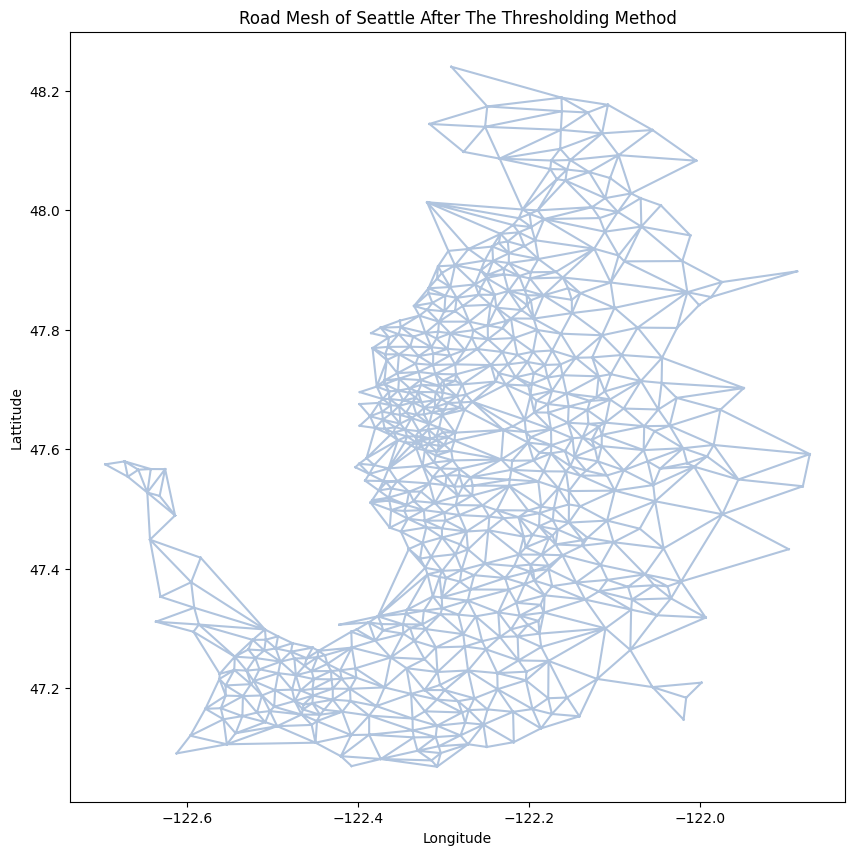

In [ ]:
tri = Delaunay(np.array([i["coordinates"] for i in g.vs]))

# distance threshold in miles
dist_thr = 13

edge_to_delete = []
for i in range(len(tri.simplices)):
    pt1 = tri.points[tri.simplices[i][0]]
    pt2 = tri.points[tri.simplices[i][1]]
    pt3 = tri.points[tri.simplices[i][2]]

    d12 = np.sqrt((pt1[0]-pt2[0])**2+(pt1[1]-pt2[1])**2)*69
    d23 = np.sqrt((pt2[0]-pt3[0])**2+(pt2[1]-pt3[1])**2)*69
    d13 = np.sqrt((pt1[0]-pt3[0])**2+(pt1[1]-pt3[1])**2)*69

    if d12 > dist_thr:
        edge_to_delete.append((tri.simplices[i][0], tri.simplices[i][1]))
    if d23 > dist_thr:
        edge_to_delete.append((tri.simplices[i][1], tri.simplices[i][2]))
    if d13 > dist_thr:
        edge_to_delete.append((tri.simplices[i][0], tri.simplices[i][2]))

simplices_to_cut = []
for simplex in tri.simplices:
    for edge in edge_to_delete:
        if edge[0] in simplex and edge[1] in simplex:
            simplices_to_cut.append(list(simplex))

tri_simplices_prune = np.array([i for i in tri.simplices if i not in np.array(simplices_to_cut)])

plt.figure(figsize=(10,10))
plt.triplot(tri.points[:, 0],
            tri.points[:, 1], 
            tri_simplices_prune, 
            c="lightsteelblue")
plt.title('Road Mesh of Seattle After The Thresholding Method')
plt.xlabel('Longitude')
plt.ylabel('Lattitude')
plt.show()

### Visualize the graph

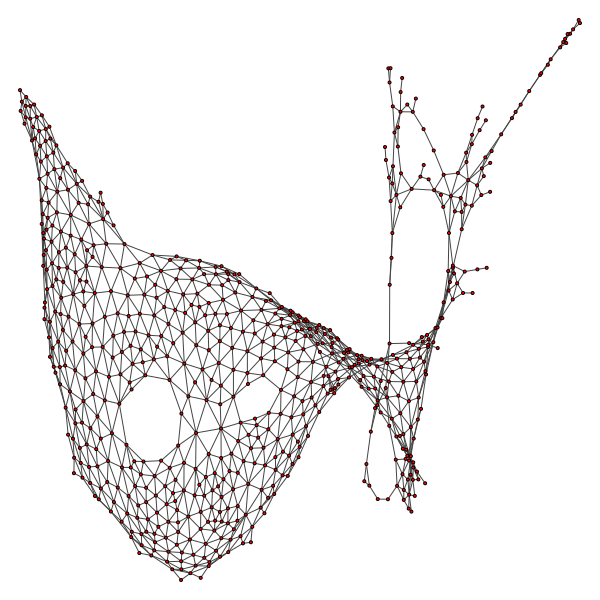

In [ ]:
edges_to_induce_prune = []

for i in range(tri_simplices_prune.shape[0]):
    for col1, col2 in ((0, 1), (1, 2), (0, 2)):
        # add the edges to edges_to_induce_prune
        try:
            edge = tuple(sorted((tri_simplices_prune[i][col1], tri_simplices_prune[i][col2])))
            e_id = g.get_eid(edge[0], edge[1])
            if edge not in edges_to_induce_prune:
                edges_to_induce_prune.append(edge)
        except:
            continue

tri_g_prune = g.subgraph_edges(edges_to_induce_prune)
plot(tri_g_prune, **dict(vertex_size=3))

### Set up the model constraints and construct the scenario

In [ ]:
road_map = deepcopy(tri_g_prune)
edge_ends = np.array([[e.source, e.target] for e in road_map.es])
sources, targets = edge_ends[:, 0], edge_ends[:, 1]
road_map_vs = np.array(road_map.vs['coordinates'])
distances = np.sqrt((road_map_vs[sources][:, 0] - road_map_vs[targets][:, 0])**2 + 
                    (road_map_vs[sources][:, 1] - road_map_vs[targets][:, 1])**2)
road_map.es['geo_distance'] = distances
vcount = len(road_map.vs)
max(distances)

# constraints
num_store = 1
num_customer = 10
total_node = num_store + num_customer
max_order = 5
num_workers = 10
deliver_capacity = 8

In [ ]:
# randomly get the restaurant and customer location index
loc_idx = random.sample(range(100, 300), total_node)
# randomly generate the number of order per costumer
num_orders = np.random.randint(1, max_order, size=total_node)
num_orders[0] = 0

# restaurant location
r_v = loc_idx[0]
r_coor = np.array(road_map.vs['coordinates'])[r_v]
print("Store ID: {:d} - Location: {}".format(r_v, r_coor))

# customers location
c_vs = loc_idx[1:]
c_coors = np.array(road_map.vs['coordinates'])[c_vs]

# summary
df = pd.DataFrame({"ids": loc_idx,
                   "longitude": np.array(road_map.vs['coordinates'])[loc_idx][:, 0],
                   "latitude": np.array(road_map.vs['coordinates'])[loc_idx][:, 1],
                   "num_orders": num_orders})
df

Store ID: 190 - Location: [-122.02195461   47.37821751]


,ids,longitude,latitude,num_orders
0,190,-122.021955,47.378218,0
1,169,-122.126520,47.615376,3
2,204,-122.266438,47.522424,2
3,249,-122.342640,47.621216,3
4,236,-122.157810,47.596787,4
5,193,-122.238917,47.713198,3
6,199,-122.339242,47.300492,2
7,244,-122.181696,47.355206,2
8,208,-122.326633,47.529032,4
9,100,-122.251537,47.408121,2


### Visualize the store and customer location

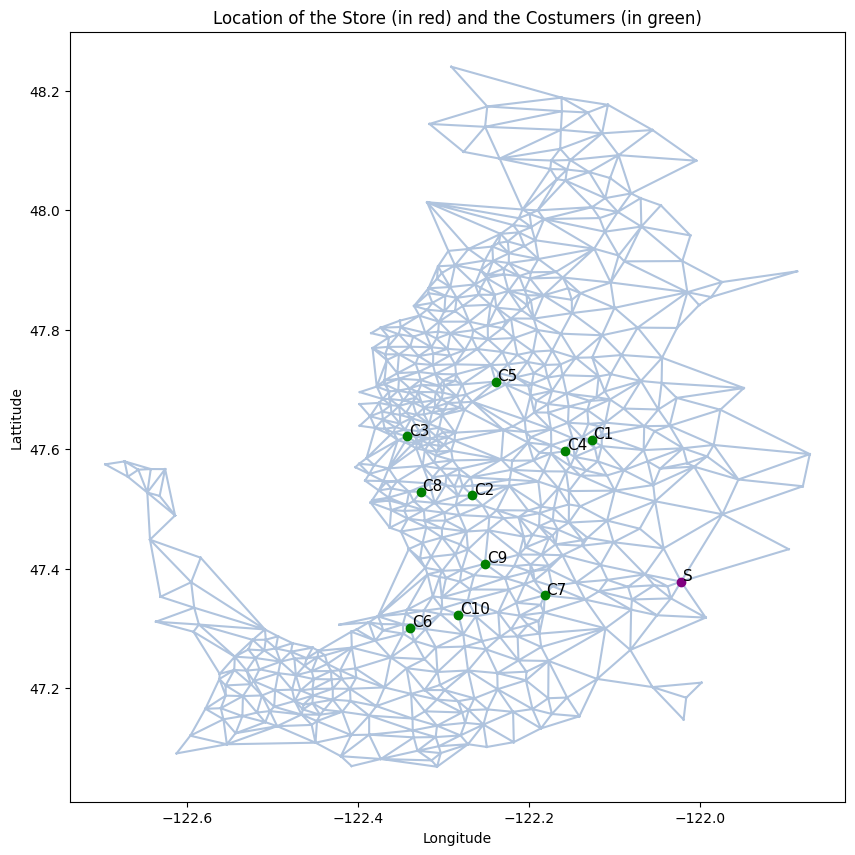

In [ ]:
# visualize the location
plt.figure(figsize=(10,10))
plt.triplot(tri.points[:, 0], tri.points[:, 1], tri_simplices_prune.copy(), c="lightsteelblue")
plt.plot(r_coor[0], r_coor[1], 'o', color='purple')
plt.text(r_coor[0]+0.002, r_coor[1]+0.002, "S", fontsize=11, color='black')
for i in range(num_customer):
    plt.plot(c_coors[i][0], c_coors[i][1], 'o', color='green')
    plt.text(c_coors[i][0]+0.002, c_coors[i][1]+0.002, f"C{i+1}", fontsize=11, color='black')
plt.title('Location of the Store (in red) and the Costumers (in green)')
plt.xlabel('Longitude')
plt.ylabel('Lattitude')
plt.show()

### Find the shortest time needed between each pair of locations

In [ ]:
shortest_time = np.zeros((total_node, total_node))
shortest_paths = {}

for i in range(total_node):
    for j in range(total_node):
        if i == j:
            shortest_time[i, j] = 0
        else:
            paths = road_map.get_shortest_paths(loc_idx[i], to=loc_idx[j], mode='all', 
                                                weights=road_map.es['weight'])[0]
            shortest_paths[(i, j)] = paths
            total_time = np.array(road_map.es['weight'])[paths].sum()
            shortest_time[i, j] = total_time
            shortest_time[j, i] = total_time

### Solve the linear programming (LP) formulation of this problem

In [ ]:
for num_worker in range(1, num_workers+1):
    LP = pulp.LpProblem("min_delivery_time", pulp.LpMinimize)

    x = [[[pulp.LpVariable("x%s_%s,%s"%(i,j,k), cat="Binary") 
           if i != j else None for k in range(num_worker)]
          for j in range(total_node)] 
         for i in range(total_node)]

    LP += pulp.lpSum(shortest_time[i][j] * x[i][j][k] if i != j else 0
                     for k in range(num_worker)
                     for j in range(total_node) 
                     for i in range (total_node))
    
    for j in range(1, total_node):
        LP += pulp.lpSum(x[i][j][k] if i != j else 0
                         for i in range(total_node) 
                         for k in range(num_worker)) == 1 

    for k in range(num_worker):
        LP += pulp.lpSum(x[0][j][k] for j in range(1, total_node)) == 1
        LP += pulp.lpSum(x[i][0][k] for i in range(1, total_node)) == 1

    for k in range(num_worker):
        for j in range(total_node):
            LP += pulp.lpSum(x[i][j][k] if i != j else 0
                             for i in range(total_node)) - pulp.lpSum(x[j][i][k] 
                                                                      for i in range(total_node)) == 0
    for k in range(num_worker):
        LP += pulp.lpSum(df.num_orders[j] * x[i][j][k] if i != j else 0 
                         for i in range(total_node) for j in range (1, total_node)) <= deliver_capacity 

    subtours = []
    for i in range(2, total_node):
         subtours += itertools.combinations(range(1, total_node), i)

    for s in subtours:
        LP += pulp.lpSum(x[i][j][k] if i !=j else 0 for i, j in itertools.permutations(s,2) 
                         for k in range(num_worker)) <= len(s) - 1

    if LP.solve() == 1:
        print('Optimal number of worker required: {}'.format(num_worker))
        hr = int(pulp.value(LP.objective)//3600)
        min = int(pulp.value(LP.objective)%3600//60)
        print('Optimal Time to deliver: {:d} hr {:d} min'.format(hr, min))
        break

Optimal number of worker required: 4
Optimal Time to deliver: 9 hr 30 min


### Visualize the final optimal routes

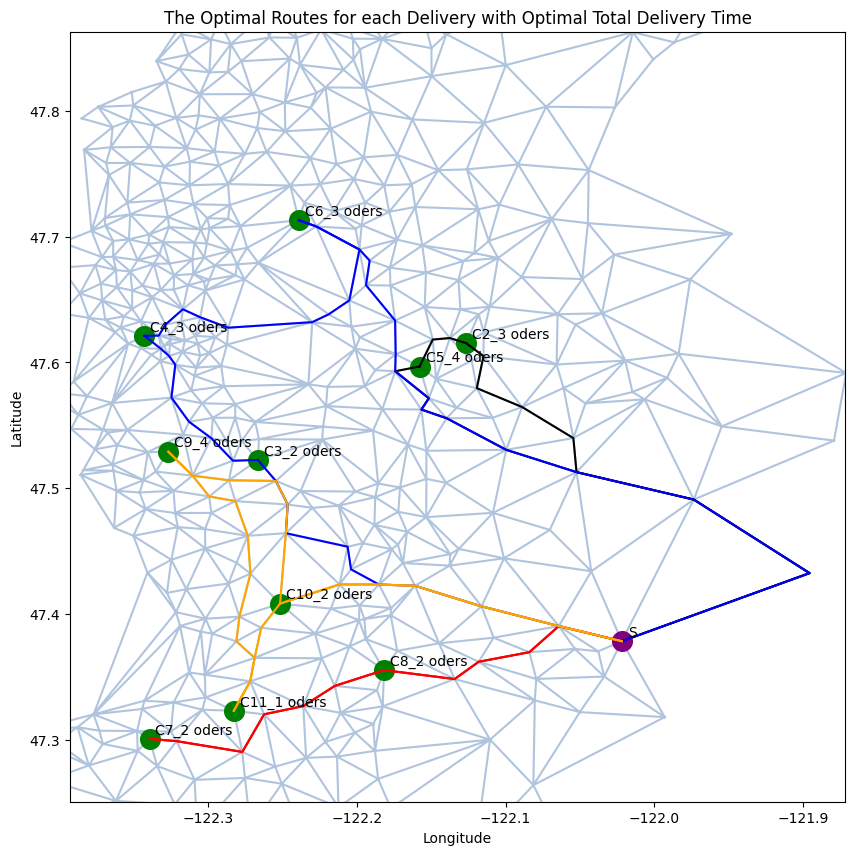

In [ ]:
plt.figure(figsize=(10, 10))
plt.triplot(tri.points[:, 0], tri.points[:, 1], tri_simplices_prune.copy(), c="lightsteelblue")
for i in range(total_node):    
    if i == 0:
        plt.scatter(df.longitude[i], df.latitude[i], c='purple', s=200)
        plt.text(df.longitude[i]+0.004, df.latitude[i]+0.004, "S", fontsize=10)
    else:
        plt.scatter(df.longitude[i], df.latitude[i], c='green', s=200)
        plt.text(df.longitude[i]+0.004, df.latitude[i]+0.004, 
                 f"C{i+1}_{df.num_orders[i]} oders", fontsize=10)

color = plt.cm.rainbow(np.linspace(0.2, 1, num_worker))
for k in range(num_worker):
    for i in range(total_node):
        for j in range(total_node):
            if i != j and pulp.value(x[i][j][k]) == 1:
                paths = shortest_paths[(i, j)]
                paths_coor = road_map_vs[paths]
                plt.plot(paths_coor[:, 0], paths_coor[:, 1], c=color[k])

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('The Optimal Routes for each Delivery with Optimal Total Delivery Time')
plt.xlim(df.longitude.min()-0.05, df.longitude.max()+0.15)
plt.ylim(df.latitude.min()-0.05, df.latitude.max()+0.15)
plt.show()

<div class="alert alert-block alert-success">
<b>Summary:</b> We have successfully helped the proprietor to decide how many people to hire for the delivery service and the best routes to drive. Based on the simplified scenario and the model result shown above, the optimal number of delivery men for the proprietor to hire is 4 people and the optimal time to finish delivering all the orders is around 9 hours and 30 minutes. The best routes for each delivery are illustrated above with different routes marked in different colors.
</div>